# **Where is waldo**
ENTORNO ENTORNO
Último checkpoint bueno ==> 43743

![Gift](https://freight.cargo.site/w/600/i/0bec2199b74fc15b8b4278ffeb46dfbc7e49b6ec94bb7dea05ace57e77bf5c10/5A_WALLY_gif_Pulando_v1.gif)

Tienes que tener la siguiente estructura de carpetas



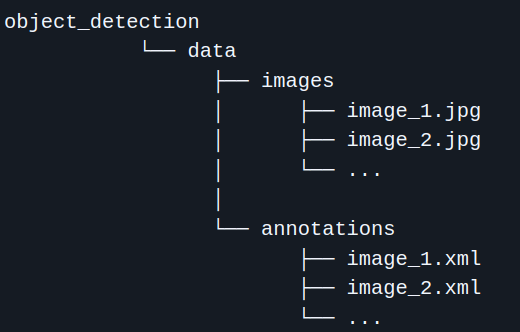

### Required Libraries

- **TensorFlow** ==> 1.15.2
- **Numpy** ==> 1.18.0
- **Pandas** ==> 0.24.2
- **Matplotlib** ==> 3.0.3
- **Scipy** ==> 1.2.2

In [1]:
# %pip install tensorflow==1.15.2      # %pip install numpy==1.16.2      # %pip install matplotlib==3.1.3      # Asegúrate de tener la versión correcta de pycocotools, si la necesitas      # %pip install pycocotools==2.0.2      # %pip install pillow      # %pip install Cython      # %pip install kiwisolver==1.1.0      # %pip install opencv-python-headless  # usa la versión headless para ambientes sin GUI      # %pip install lvis --no-deps

In [2]:
import sys
import os

# Rutas absolutas al directorio `research` y `slim`
research_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research"
slim_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/slim"

if research_path not in sys.path:
    sys.path.append(research_path)
if slim_path not in sys.path:
    sys.path.append(slim_path)

print("PYTHONPATH:", sys.path)

PYTHONPATH: ['/mnt/homeGPU/azapata', '/mnt/homeGPU/azapata/ENTORNO/lib/python37.zip', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/lib-dynload', '', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages/IPython/extensions', '/home/azapata/.ipython', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/slim']


In [3]:
# Required Libraries

from __future__ import division, print_function, absolute_import
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

from PIL import Image, ImageDraw, ImageEnhance
from tensorflow import keras
from collections import namedtuple, OrderedDict
from object_detection.utils import dataset_util
from collections import defaultdict
from io import StringIO
from object_detection.utils import ops as utils_ops

import tensorflow as tf
print("TensorFlow Version is " +  tf.__version__)

import numpy as np
print("Numpy Version is " +  np.__version__)

import pandas as pd
print("Pandas Version is " + pd.__version__)

import re
import io
import csv
import cv2 
import glob
import random
import shutil
import tarfile
import urllib.request
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
import six.moves.urllib as urllib
import zipfile

TensorFlow Version is 1.15.2
Numpy Version is 1.16.2
Pandas Version is 0.24.2


In [4]:
import sys
import os

# Rutas absolutas al directorio `research` y `slim`
research_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research"
slim_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/slim"

if research_path not in sys.path:
    sys.path.append(research_path)
if slim_path not in sys.path:
    sys.path.append(slim_path)

print("PYTHONPATH:", sys.path)


PYTHONPATH: ['/mnt/homeGPU/azapata', '/mnt/homeGPU/azapata/ENTORNO/lib/python37.zip', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/lib-dynload', '', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages', '/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages/IPython/extensions', '/home/azapata/.ipython', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/slim']


# Función para visualizar las imágenes con su bounding box real

In [5]:
def show_image_with_bounding_box(xml_path, image_path):
    # Cargar la imagen
    image = Image.open(image_path).convert("RGB")
    
    # Intentar leer el contenido del archivo XML
    try:
        with open(xml_path, 'r') as file:
            content = file.read().strip()  # Eliminar espacios en blanco y saltos de línea
            
        # Verificar si el archivo contiene "-1", lo que indica que no hay detecciones
        if content == "-1":
            print(f"El archivo de etiquetas {xml_path} indica que no hay detecciones. Mostrando la imagen sin bounding boxes.")
            plt.figure(figsize=(18, 18))
            plt.imshow(image)
            plt.axis('off')
            plt.show()
            return  # Salir de la función si el XML indica que no hay detecciones

        # Parsear el contenido XML
        root = ET.fromstring(content)
        
        # Crear una capa para las bounding boxes
        overlay = Image.new("RGBA", image.size, (255, 255, 255, 0))
        
        # Obtener y dibujar las coordenadas de cada bounding box en el overlay
        for obj in root.findall('object'):
            xmin = int(obj.find('bndbox/xmin').text)
            ymin = int(obj.find('bndbox/ymin').text)
            xmax = int(obj.find('bndbox/xmax').text)
            ymax = int(obj.find('bndbox/ymax').text)
            
            draw = ImageDraw.Draw(overlay)
            draw.rectangle([(xmin, ymin), (xmax, ymax)], outline="green", width=4, fill=(0, 255, 0, 100))

        # Superponer el overlay con las bounding boxes sobre la imagen original
        combined = Image.alpha_composite(image.convert("RGBA"), overlay).convert("RGB")
        
    except ET.ParseError:
        # En caso de error de parseo, mostrar solo la imagen sin bounding boxes
        print(f"Error al analizar {xml_path}. Mostrando la imagen sin bounding boxes.")
        combined = image

    # Mostrar la imagen resultante
    plt.figure(figsize=(18, 18))
    plt.imshow(combined)
    plt.axis('off')
    plt.show()


# Ejemplo de uso:
show_image_with_bounding_box("/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/data/annotations/1.xml", "/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/data/images/1.jpg")


# **Creación de Carpetas para Datos de Entrenamiento y Prueba**

En esta celda se crea la estructura de directorios necesaria para almacenar los archivos de etiquetas correspondientes a los conjuntos de datos de **entrenamiento** y **prueba**.

- **Objetivo**: Crear las carpetas `train_labels` y `test_labels` dentro del directorio de datos (`/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/`), donde se almacenarán los archivos de etiquetas (anotaciones) para el modelo de detección de objetos.

In [6]:
!mkdir /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels

mkdir: cannot create directory ‘/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels’: File exists
mkdir: cannot create directory ‘/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels’: File exists


Comprobamos que todo se haya creado con la estructura que buscábamos

In [7]:
%cd /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data
!ls -R

/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data
.:
annotations	 test_labels	     train_labels
images		 test_labels.csv     train_labels.csv
label_map.pbtxt  test_labels.record  train_labels.record

./annotations:
1.xml	  110.xml   120G.xml	 27.xml  56B.xml  67.xml   79.xml   89G.xml
10.xml	  110B.xml  121.xml	 28.xml  56G.xml  67B.xml  79B.xml  9.xml
100.xml   110G.xml  121B.xml	 29.xml  57.xml   67G.xml  79G.xml  90.xml
100B.xml  111.xml   121G.xml	 3.xml	 57B.xml  68.xml   8.xml    90B.xml
100G.xml  111B.xml  122.xml	 30.xml  57G.xml  68B.xml  80.xml   90G.xml
101.xml   111G.xml  122B.xml	 31.xml  58.xml   68G.xml  80B.xml  91.xml
101B.xml  112.xml   122G.xml	 32.xml  58B.xml  69.xml   80G.xml  91B.xml
101G.xml  112B.xml  123.xml	 33.xml  58G.xml  69B.xml  81.xml   91G.xml
102.xml   112G.xml  123B.xml	 34.xml  59.xml   69G.xml  81B.xml  92.xml
102B.xml  113.xml   123G.xml	 35.xml  59B.xml  7.xml    81G.xml  92B.xml
102G.xml  113B.xml  124.xml	 36.xml  59G.xml  70.xml   82.xml 

# **Preparación de los Datos de Entrenamiento y Prueba**

Esta celda de código realiza la preparación de los archivos de anotaciones (en formato XML) para dividirlos en dos conjuntos: uno para **entrenamiento** y otro para **prueba**. La división se realiza en cada ejecución del código, pero de manera **reproducible** gracias al uso de una **semilla fija**. 

In [8]:
# Ruta a las carpetas
annotations_dir = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/annotations/'
train_labels_dir = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels/'
test_labels_dir = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels/'

random.seed(42)

# Verificar que los directorios de train_labels y test_labels estén vacíos
def ensure_empty_directory(directory):
    if os.listdir(directory):
        print(f'El directorio {directory} no está vacío. Limpiando...')
        # Si no está vacío, eliminar todos los archivos dentro
        for file in os.listdir(directory):
            file_path = os.path.join(directory, file)
            os.remove(file_path)
    else:
        print(f'El directorio {directory} está vacío. Continuando...')

# Asegurarse de que ambos directorios estén vacíos
ensure_empty_directory(train_labels_dir)
ensure_empty_directory(test_labels_dir)

# Crear listas de archivos XML en la carpeta de anotaciones
xml_files = [f for f in os.listdir(annotations_dir) if f.endswith('.xml')]

# Verificar que haya archivos en la carpeta de anotaciones
if not xml_files:
    print("No se encontraron archivos XML en la carpeta de anotaciones.")
else:
    # Fijar la semilla para que la división sea reproducible
    random.seed(42)  # Elige cualquier número para la semilla, el 42 es solo un ejemplo.
    random.shuffle(xml_files)

    # Definir el porcentaje de datos para entrenamiento
    split_ratio = 0.8
    train_size = int(len(xml_files) * split_ratio)

    # Dividir los archivos en entrenamiento y prueba
    train_files = xml_files[:train_size]
    test_files = xml_files[train_size:]

    # Copiar archivos de entrenamiento
    for file in train_files:
        shutil.copy(os.path.join(annotations_dir, file), os.path.join(train_labels_dir, file))

    # Copiar archivos de prueba
    for file in test_files:
        shutil.copy(os.path.join(annotations_dir, file), os.path.join(test_labels_dir, file))

    print(f'Copiados {len(train_files)} archivos a train_labels y {len(test_files)} archivos a test_labels.')


El directorio /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels/ no está vacío. Limpiando...


El directorio /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels/ no está vacío. Limpiando...
Copiados 210 archivos a train_labels y 53 archivos a test_labels.


Comprobamos que todo se haya generado correctamente

In [9]:
!ls -R

.:
annotations	 test_labels	     train_labels
images		 test_labels.csv     train_labels.csv
label_map.pbtxt  test_labels.record  train_labels.record

./annotations:
1.xml	  110.xml   120G.xml	 27.xml  56B.xml  67.xml   79.xml   89G.xml
10.xml	  110B.xml  121.xml	 28.xml  56G.xml  67B.xml  79B.xml  9.xml
100.xml   110G.xml  121B.xml	 29.xml  57.xml   67G.xml  79G.xml  90.xml
100B.xml  111.xml   121G.xml	 3.xml	 57B.xml  68.xml   8.xml    90B.xml
100G.xml  111B.xml  122.xml	 30.xml  57G.xml  68B.xml  80.xml   90G.xml
101.xml   111G.xml  122B.xml	 31.xml  58.xml   68G.xml  80B.xml  91.xml
101B.xml  112.xml   122G.xml	 32.xml  58B.xml  69.xml   80G.xml  91B.xml
101G.xml  112B.xml  123.xml	 33.xml  58G.xml  69B.xml  81.xml   91G.xml
102.xml   112G.xml  123B.xml	 34.xml  59.xml   69G.xml  81B.xml  92.xml
102B.xml  113.xml   123G.xml	 35.xml  59B.xml  7.xml    81G.xml  92B.xml
102G.xml  113B.xml  124.xml	 36.xml  59G.xml  70.xml   82.xml   92G.xml
103.xml   113G.xml  124B.xml	 37.xml  6.xml	 

# **Conversión de Anotaciones XML a CSV y Creación del Archivo `label_map.pbtxt`**

Este código realiza dos tareas principales:
1. Convierte los archivos de anotaciones en formato **XML** a formato **CSV**.
2. Genera el archivo `label_map.pbtxt`, que es utilizado por el modelo para asociar las clases detectadas con sus etiquetas correspondientes.

#### **Función `xml_to_csv(path)`**
- **Objetivo**: Convertir las anotaciones de los archivos XML a un formato tabular (CSV), más fácil de manejar por el modelo de detección de objetos.

#### **Creación del archivo `label_map.pbtxt`**
- **Objetivo**: Crear el archivo `label_map.pbtxt` que asocia las clases de los objetos detectados con un ID numérico. Este archivo es necesario para el modelo de detección de objetos de TensorFlow.

### **Resultados:**
- **Archivos CSV**: Convertidos a partir de las anotaciones XML, almacenando las etiquetas y coordenadas de los objetos en las imágenes.
- **Archivo `label_map.pbtxt`**: Un archivo que asocia las clases detectadas con sus nombres y un identificador numérico, necesario para el entrenamiento del modelo.

In [10]:
def xml_to_csv(path):
  classes_names = []
  xml_list = []

  for xml_file in glob.glob(path + '/*.xml'):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    for member in root.findall('object'):
      classes_names.append(member[0].text)
      value = (root.find('filename').text,
               int(root.find('size')[0].text),
               int(root.find('size')[1].text),
               member[0].text,
               int(member[4][0].text),
               int(member[4][1].text),
               int(member[4][2].text),
               int(member[4][3].text))
      xml_list.append(value)
  column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
  xml_df = pd.DataFrame(xml_list, columns=column_name) 
  classes_names = list(set(classes_names))
  classes_names.sort()
  return xml_df, classes_names

for label_path in ['train_labels', 'test_labels']:
  image_path = os.path.join(os.getcwd(), label_path)
  xml_df, classes = xml_to_csv(label_path)
  xml_df.to_csv(f'{label_path}.csv', index=None)
  print(f'Successfully converted {label_path} xml to csv.')

label_map_path = os.path.join("label_map.pbtxt")
pbtxt_content = ""

for i, class_name in enumerate(classes):
    pbtxt_content = (
        pbtxt_content
        + "item {{\n    id: {0}\n    name: '{1}'\n}}\n\n".format(i + 1, class_name)
    )
pbtxt_content = pbtxt_content.strip()
with open(label_map_path, "w") as f:
    f.write(pbtxt_content)

Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.


Revisamos que sea cierto

In [11]:
!cat /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels.csv
!cat /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels.csv

filename,width,height,class,xmin,ymin,xmax,ymax
107B.jpg,256,256,Waldo,132,179,191,256
23.jpg,600,429,Waldo,40,17,44,23
60B.jpg,64,64,Waldo,17,37,43,64
65B.jpg,64,64,Waldo,45,31,63,60
73B.jpg,64,64,Waldo,1,18,30,64
74G.jpg,64,64,Waldo,3,25,28,64
117.jpg,256,256,Waldo,27,54,89,125
81B.jpg,128,128,Waldo,18,99,41,128
113G.jpg,256,256,Waldo,168,224,193,256
118.jpg,591,629,Waldo,165,16,206,54
118.jpg,591,629,Waldo,235,3,323,180
118.jpg,591,629,Waldo,342,1,417,180
118.jpg,591,629,Waldo,430,2,499,176
118.jpg,591,629,Waldo,518,10,580,177
118.jpg,591,629,Waldo,94,269,113,297
72G.jpg,64,64,Waldo,55,41,64,64
93G.jpg,128,128,Waldo,25,1,69,117
103.jpg,256,256,Waldo,231,78,256,118
16_10_4.jpg,64,64,Waldo,26,1,60,64
38.jpg,1590,981,Waldo,1263,76,1297,116
73.jpg,64,64,Waldo,1,1,23,34
107G.jpg,256,256,Waldo,134,174,188,256
41.jpg,2999,1868,Waldo,500,1303,533,1358
18_2_14.jpg,64,64,Waldo,1,44,13,64
87B.jpg,128,128,Waldo,102,30,128,72
117B.jpg,256,256,Waldo,25,55,91,127
100G.jpg,256,256,Waldo,147,226,173

filename,width,height,class,xmin,ymin,xmax,ymax
9.jpg,1298,951,Waldo,229,732,269,773
70.jpg,64,64,Waldo,1,1,57,37
122B.jpg,154,348,Waldo,9,15,147,342
79B.jpg,128,128,Waldo,89,82,107,114
102B.jpg,256,256,Waldo,213,208,238,242
122G.jpg,154,348,Waldo,4,13,144,338
121B.jpg,178,350,Waldo,2,7,166,343
80.jpg,128,128,Waldo,103,78,128,117
106B.jpg,256,256,Waldo,231,30,256,72
95.jpg,128,128,Waldo,1,44,43,111
28.jpg,900,648,Waldo,676,494,700,525
4.jpg,2048,1272,Waldo,1486,276,1515,313
99G.jpg,256,256,Waldo,229,76,256,118
69G.jpg,64,64,Waldo,1,20,54,64
64G.jpg,64,64,Waldo,46,8,63,64
71B.jpg,64,64,Waldo,57,39,63,64
72.jpg,64,64,Waldo,55,42,63,64
94B.jpg,128,128,Waldo,79,68,109,106
68.jpg,64,64,Waldo,5,1,60,64
1.jpg,2048,1251,Waldo,703,511,752,582
75B.jpg,64,64,Waldo,29,2,64,49
78.jpg,128,128,Waldo,7,41,24,90
90.jpg,128,128,Waldo,115,44,128,84
62B.jpg,64,64,Waldo,38,17,64,53
6.jpg,2048,1454,Waldo,1716,400,1760,476
120.jpg,172,364,Waldo,2,2,172,358
94.jpg,128,128,Waldo,82,72,112,116
59G.jpg,64,64,Wal

# Setup del modelo de Tensorflow

Descargamos el modelo si no lo tenemos descargado. Este tiene que quedar en la carpeta models/research/

Aquí es donde nos estamos descargando el SSD Mobilenet v2 preenternado junto a otros disponibles en ese github.

In [12]:
# %cd /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection
# !git clone --q https://github.com/tensorflow/models.git

In [13]:
!pwd
%cd /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/

/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data


/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research


Compilamos los proto buffers, que son archivos necesarios para el procesamiento de datos del modelo

In [14]:
# !mv protoc/bin/protoc /mnt/homeGPU/azapata/WhereIsWaldo  # O cualquier otra ruta en tu PATH

# !/mnt/homeGPU/azapata/WhereIsWaldo/protoc --version

# !chmod +x /mnt/homeGPU/azapata/WhereIsWaldo/protoc

# %pip install protobuf==3.20.1


In [15]:
!/mnt/homeGPU/azapata/WhereIsWaldo/protoc object_detection/protos/*.proto --python_out=.

# **Verificación y Configuración del `PYTHONPATH`**

Este código verifica y modifica la variable de entorno `PYTHONPATH`, asegurándose de que incluya las rutas necesarias para ejecutar correctamente el código relacionado con la detección de objetos en TensorFlow.

#### Importancia:

- **`PYTHONPATH`**: Es crucial en entornos de desarrollo como el de detección de objetos de TensorFlow, ya que permite que Python encuentre los módulos necesarios (como los modelos de detección de objetos y los componentes de `slim`, que es parte del modelo).

In [16]:
# Verificamos si 'PYTHONPATH' está en el entorno, si no lo está, lo inicializamos.
if 'PYTHONPATH' not in os.environ:
    os.environ['PYTHONPATH'] = ''

# Definimos la ruta a agregar.
path_to_add = ':./:./slim/'

# Agregamos la ruta solo si no está ya presente en PYTHONPATH.
if path_to_add not in os.environ['PYTHONPATH']:
    os.environ['PYTHONPATH'] += path_to_add

print("PYTHONPATH:", os.environ['PYTHONPATH'])

PYTHONPATH: :./:./slim/


# **Verificación de la configuración del modelo con `model_builder_test.p`**

In [17]:
!python3 object_detection/builders/model_builder_test.py

In [18]:
!pwd

/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research


# **Conversión de Anotaciones en CSV a TFRecord para TensorFlow**

Este código realiza la conversión de los archivos de anotaciones en formato CSV a **TFRecord**, el formato binario optimizado que TensorFlow utiliza para el entrenamiento y evaluación de modelos.

#### Resultado:

- Se generan dos archivos `.record` en formato TFRecord:
    - `train_labels.record`: Contiene los ejemplos de entrenamiento.
    - `test_labels.record`: Contiene los ejemplos de prueba.
  
Estos archivos serán utilizados en el proceso de entrenamiento y evaluación del modelo de detección de objetos en TensorFlow, mejorando la eficiencia y el rendimiento del procesamiento de los datos.

In [19]:
!pwd

from object_detection.utils import dataset_util

DATA_BASE_PATH = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/'
image_dir = DATA_BASE_PATH +'data/images/'

# Convierte el nombre de la clase (en este caso, 'Waldo') a un entero, que será utilizado como etiqueta en el proceso de entrenamiento. Esta función se puede modificar para manejar múltiples clases.
def class_text_to_int(row_label):
		if row_label == 'Waldo':
				return 1
		else:
			  None

# Agrupa el DataFrame (`df`) de anotaciones en función del nombre de los archivos de imagen (`filename`). Esto es útil para preparar los datos de entrada organizados por cada imagen.
def split(df, group):
		data = namedtuple('data', ['filename', 'object'])
		gb = df.groupby(group)
		return [data(filename, gb.get_group(x)) for filename, x in zip(gb.groups.keys(), gb.groups)]

# El formato binario de este ejemplo es el que se guarda en el archivo TFRecord para la creación de futuros archivos.
def create_tf_example(group, path):
		with tf.io.gfile.GFile(os.path.join(path, '{}'.format(group.filename)), 'rb') as fid:
				encoded_jpg = fid.read()
		encoded_jpg_io = io.BytesIO(encoded_jpg)
		image = Image.open(encoded_jpg_io)
		width, height = image.size


		filename = group.filename.encode('utf8')
		image_format = b'jpg'
		xmins = []
		xmaxs = []
		ymins = []
		ymaxs = []
		classes_text = []
		classes = []

		for index, row in group.object.iterrows():
				xmins.append(row['xmin'] / width)
				xmaxs.append(row['xmax'] / width)
				ymins.append(row['ymin'] / height)
				ymaxs.append(row['ymax'] / height)
				classes_text.append(row['class'].encode('utf8'))
				classes.append(class_text_to_int(row['class']))

		tf_example = tf.train.Example(features=tf.train.Features(feature={
				'image/height': dataset_util.int64_feature(height),
				'image/width': dataset_util.int64_feature(width),
				'image/filename': dataset_util.bytes_feature(filename),
				'image/source_id': dataset_util.bytes_feature(filename),
				'image/encoded': dataset_util.bytes_feature(encoded_jpg),
				'image/format': dataset_util.bytes_feature(image_format),
				'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
				'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
				'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
				'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
				'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
				'image/object/class/label': dataset_util.int64_list_feature(classes),
		}))
		return tf_example

# Proceso de conversión de CSV a TFRecord
for csv in ['data/train_labels', 'data/test_labels']:
  writer = tf.io.TFRecordWriter(DATA_BASE_PATH + csv + '.record')
  path = os.path.join(image_dir)
  examples = pd.read_csv(DATA_BASE_PATH + csv + '.csv')
  grouped = split(examples, 'filename')
  for group in grouped:
      tf_example = create_tf_example(group, path)
      writer.write(tf_example.SerializeToString())
    
  writer.close()
  output_path = os.path.join(os.getcwd(), DATA_BASE_PATH + csv + '.record')
  print('Successfully created the TFRecords: {}'.format(DATA_BASE_PATH +csv + '.record'))


/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research


Successfully created the TFRecords: /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels.record
Successfully created the TFRecords: /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels.record


Guardamos los paths para los records y para los pbtxt para tener un acceso más fácil más tarde

In [20]:
train_record_fname = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels.record'
test_record_fname = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels.record'
label_map_pbtxt_fname = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/label_map.pbtxt'

# **Descarga y Preparación del Modelo Preentrenado para Detección de Objetos**

Este código se encarga de descargar y preparar el modelo preentrenado de detección de objetos que se utilizará en el entrenamiento.


#### Resultado:
- El modelo preentrenado seleccionado (`faster_rcnn_inception_v2_coco`) se descarga, descomprime y se guarda en la carpeta especificada (`/pretrained_model`). Este modelo será utilizado como punto de partida para realizar el entrenamiento en el conjunto de datos personalizado.

In [ ]:
%%writefile /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/samples/configs/ssd_mobilenet_v2_coco.config

# Configuración del modelo SSD Mobilenet v2 para la detección de objetos
model {
  ssd {
    num_classes: 1  # Número de clases a detectar (en este caso solo Waldo)
    
    # Configuración del codificador de las cajas delimitadoras (bounding boxes)
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0  # Escalas utilizadas para ajustar las predicciones
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }

    # Configuración del emparejador para las cajas detectadas
    matcher {
      argmax_matcher {
        matched_threshold: 0.5  # Umbral para considerar un objeto correctamente detectado
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
      }
    }

    # Calculadora de similitud (IOU - Intersection over Union)
    similarity_calculator {
      iou_similarity {
      }
    }

    # Generador de anclas (anchors) para la detección de objetos
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6  # Número de capas de anclas
        min_scale: 0.2  # Escala mínima y máxima para las anclas
        max_scale: 0.95
        # Diferentes proporciones de aspecto para los cuadros delimitadores
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_ratios: 0.5
        aspect_ratios: 3.0
        aspect_ratios: 0.3333
      }
    }

    # Redimensionamiento de las imágenes a 300x300 píxeles
    image_resizer {  
      fixed_shape_resizer {
        height: 300
        width: 300
      }
    }

    # Predictor de cajas (bounding boxes)
    box_predictor {
      convolutional_box_predictor {
        min_depth: 0
        max_depth: 0
        num_layers_before_predictor: 0
        use_dropout: true  # Uso de dropout para evitar sobreajuste
        dropout_keep_probability: 0.8
        kernel_size: 1
        box_code_size: 4
        apply_sigmoid_to_scores: false
        # Configuración de los hiperparámetros para las capas convolucionales
        conv_hyperparams {
          activation: RELU_6  # Función de activación ReLU6
          regularizer {
            l2_regularizer {  # Regularización L2 para evitar el sobreajuste
              weight: 0.0001
            }
          }
          initializer {
            truncated_normal_initializer {  # Inicialización de pesos
              stddev: 0.03
              mean: 0.0
            }
          }
          batch_norm {  # Normalización por lotes (batch normalization)
            train: true
            scale: true
            center: true
            decay: 0.9997
            epsilon: 0.001
          }
        }
      }
    }

    # Extractor de características basado en Mobilenet v2
    feature_extractor {
      type: 'ssd_mobilenet_v2'
      min_depth: 16
      depth_multiplier: 1.0
      conv_hyperparams {  # Hiperparámetros para la convolución
        activation: RELU_6
        regularizer {
          l2_regularizer {
            weight: 0.001
          }
        }
        initializer {
          truncated_normal_initializer {
            stddev: 0.03
            mean: 0.0
          }
        }
        batch_norm {
          train: true
          scale: true
          center: true
          decay: 0.9997
          epsilon: 0.001
        }
      }
    }

    # Configuración de las funciones de pérdida (losses)
    loss {
      classification_loss {
        weighted_sigmoid {
        }
      }
      localization_loss {
        weighted_smooth_l1 {
        }
      }
      hard_example_miner {  # Para mejorar el aprendizaje con ejemplos difíciles
        num_hard_examples: 3000
        iou_threshold: 0.99
        loss_type: CLASSIFICATION
        max_negatives_per_positive: 3
        min_negatives_per_image: 3
      }
      classification_weight: 1.0
      localization_weight: 1.0
    }

    # Normalización de la pérdida por el número de coincidencias
    normalize_loss_by_num_matches: true

    # Configuración del postprocesamiento para las detecciones
    post_processing {
      batch_non_max_suppression {
        score_threshold: 1e-8  # Umbral para las puntuaciones
        iou_threshold: 0.6  # Umbral de IOU para la supresión de cuadros no máximos
        max_detections_per_class: 100
        max_total_detections: 100
      }
      score_converter: SIGMOID  # Conversión de las puntuaciones a probabilidades
    }
  }
}

# Configuración del entrenamiento
train_config: {
  batch_size: 24  # Tamaño del lote de entrenamiento
  optimizer {  # Optimizador RMSProp con decaimiento exponencial
    rms_prop_optimizer: {
      learning_rate: {
        exponential_decay_learning_rate {
          initial_learning_rate: 0.004  # Tasa de aprendizaje inicial
          decay_steps: 800720
          decay_factor: 0.95
        }
      }
      momentum_optimizer_value: 0.9
      decay: 0.9
      epsilon: 1.0
    }
  }
  
  # Punto de control (checkpoint) preentrenado para hacer ajuste fino (fine-tuning)
  fine_tune_checkpoint: "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/pretrained_model/model.ckpt"
  fine_tune_checkpoint_type:  "detection"  # Tipo de punto de control (detección)
  from_detection_checkpoint: true  # Indica que es un checkpoint de detección
  load_all_detection_checkpoint_vars: true  # Carga todas las variables del checkpoint

  num_steps: 200000  # Número de pasos de entrenamiento
  data_augmentation_options {  # Opciones de aumento de datos
    random_horizontal_flip {  # Volteo horizontal aleatorio
    }
  }
  data_augmentation_options {
    ssd_random_crop {  # Recorte aleatorio
    }
  }
}

# Configuración del lector de datos de entrenamiento
train_input_reader: {
  tf_record_input_reader {  # Lectura de datos en formato TFRecord
    input_path: "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/train_labels.record"
  }
  label_map_path: "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/label_map.pbtxt"
}

# Configuración de la evaluación
eval_config: {
  num_examples: 2000  # Número de ejemplos para la evaluación
  max_evals: 15  # Número máximo de evaluaciones
  num_visualizations: 45  # Número de visualizaciones generadas durante la evaluación
  min_score_threshold: 0.2  # Umbral mínimo de puntuación para considerar una detección válida
}

# Configuración del lector de datos de evaluación
eval_input_reader: {
  tf_record_input_reader {  # Lectura de datos de evaluación en formato TFRecord
    input_path: "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/test_labels.record"
  }
  label_map_path: "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/data/label_map.pbtxt"
  shuffle: false  # No barajar los datos de evaluación
  num_readers: 1  # Número de lectores de datos
}


Overwriting /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/samples/configs/ssd_mobilenet_v2_coco.config


Comprobamos si la configuración es correcta

In [22]:
!cat /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/samples/configs/ssd_mobilenet_v2_coco.config


# Configuración del modelo SSD Mobilenet v2 para la detección de objetos
model {
  ssd {
    num_classes: 1  # Número de clases a detectar (en este caso solo Waldo)
    
    # Configuración del codificador de las cajas delimitadoras (bounding boxes)
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0  # Escalas utilizadas para ajustar las predicciones
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }

    # Configuración del emparejador para las cajas detectadas
    matcher {
      argmax_matcher {
        matched_threshold: 0.5  # Umbral para considerar un objeto correctamente detectado
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
      }
    }

    # Calculadora de similitud (IOU - Intersection over Union)
    similarity_calculator {
      iou_similarity {
      }
    }

    # Generador de anclas (anchors) para la detección de 

# **Configuración de Tensorboard con Ngrok para Acceso Remoto**

En esta celda se configura **Tensorboard** para monitorear el entrenamiento del modelo de forma remota, utilizando **Ngrok** para crear un túnel que permita acceder a Tensorboard a través de una URL pública.

#### Resultado:
- Al final del proceso, se genera una **URL pública** accesible desde cualquier navegador, donde se puede monitorear el progreso del entrenamiento en tiempo real mediante **Tensorboard**. Este enfoque es especialmente útil cuando el entorno de ejecución no tiene acceso directo a la interfaz gráfica del usuario (por ejemplo, en servidores remotos o Google Colab).

In [23]:
!wget https://bin.equinox.io/c/bNyj1mQVY4c/ngrok-v3-stable-linux-amd64.tgz
!tar -xvzf ngrok-v3-stable-linux-amd64.tgz
!./ngrok authtoken 2mtB9DTXFK86bPztzIxiEAUZK12_5724FgvnitpcB6VZVBNEi
LOG_DIR = "training/"
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6060 &'.format(LOG_DIR)
)
get_ipython().system_raw('./ngrok http 6060 &')
!curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

--2024-11-03 18:37:45--  https://bin.equinox.io/c/bNyj1mQVY4c/ngrok-v3-stable-linux-amd64.tgz
Resolving bin.equinox.io (bin.equinox.io)... 99.83.220.108, 75.2.60.68, 35.71.179.82, ...
Connecting to bin.equinox.io (bin.equinox.io)|99.83.220.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14794913 (14M) [application/octet-stream]
Saving to: ‘ngrok-v3-stable-linux-amd64.tgz.77’

ngrok-v3-stable-lin 100%[===================>]  14.11M  6.95MB/s    in 2.0s    

2024-11-03 18:37:48 (6.95 MB/s) - ‘ngrok-v3-stable-linux-amd64.tgz.77’ saved [14794913/14794913]

ngrok
Authtoken saved to configuration file: /home/azapata/.config/ngrok/ngrok.yml
Traceback (most recent call last):
  File "<string>", line 1, in <module>
IndexError: list index out of range


# **Proceso de Entrenamiento y Exportación del Modelo de Detección de Objetos**

Este código realiza el entrenamiento del modelo **SSD Mobilenet v2** para la detección de objetos y luego exporta el modelo entrenado junto con el gráfico de inferencia para su uso posterior.

#### Resultado:

- **Modelo Entrenado**: El modelo es entrenado utilizando los datos definidos en el archivo de configuración y los checkpoints se guardan en el directorio `training/`.
- **Gráfico de Inferencia**: Se exporta el modelo entrenado junto con el gráfico de inferencia a la carpeta `fine_tuned_model`. Este gráfico es lo que se utilizará para realizar predicciones (detección de objetos) en imágenes nuevas.

# **AQUI SE ENTRENA**

Hay que estar en el directorio: `/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/models/research`

In [24]:
!pwd

/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research


In [ ]:
# !python3 /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/model_main.py \
#     --pipeline_config_path=/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/samples/configs/ssd_mobilenet_v2_coco.config \
#     --model_dir=training/

# **Exportación de Modelo con Faster R-CNN**

Este script busca el último modelo guardado de entrenamiento y lo exporta en un formato listo para inferencia con Faster R-CNN, usando TensorFlow y Keras.

In [26]:
import os
import shutil
import numpy as np
import re
import tensorflow as tf
from tensorflow.keras.applications import ResNet50

# Define the output directory for the exported model
output_directory = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/fine_tuned_model'

# Clear the output directory if it exists
if os.path.exists(output_directory):
    shutil.rmtree(output_directory)

# Find the latest checkpoint in the training directory
lst = os.listdir('/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/training')
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps = np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join('training', last_model)

# last_model_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/training/model.ckpt-43535" 

# Set up the export command
export_command = (
    f"python /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/export_inference_graph.py "
    f"--input_type=image_tensor "
    f"--pipeline_config_path=/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/object_detection/samples/configs/ssd_mobilenet_v2_coco.config "
    f"--output_directory={output_directory} "
    f"--trained_checkpoint_prefix={last_model_path}"
)

# Run the export command
if not os.system(export_command) == 0:
    raise Exception("Model export failed.")

# Optionally, verify the export was successful
if not os.path.exists(os.path.join(output_directory, 'saved_model')):
    raise FileNotFoundError("Exported model not found in the expected directory.")


print(f"Exported Model {last_model_path} to {os.path.join(output_directory, 'saved_model')}")

W1103 18:37:54.603626 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:37:54.640711 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
Instructions for updating:
Please use `layer.__call__` method instead.
W1103 18:37:54.714727 140294908524352 deprecation.py:323] From /mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
W1103 18:37:54.989825 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or mor

Parsing Inputs...

=========================Options=============================
-max_depth                  10000
-min_bytes                  0
-min_peak_bytes             0
-min_residual_bytes         0
-min_output_bytes           0
-min_micros                 0
-min_accelerator_micros     0
-min_cpu_micros             0
-min_params                 0
-min_float_ops              0
-min_occurrence             0
-step                       -1
-order_by                   name
-account_type_regexes       _trainable_variables
-start_name_regexes         .*
-trim_name_regexes          .*BatchNorm.*
-show_name_regexes          .*
-hide_name_regexes          
-account_displayed_op_only  true
-select                     params
-output                     stdout:

==================Model Analysis Report======================

Doc:
scope: The nodes in the model graph are organized by their names, which is hierarchical like filesystem.
param: Number of parameters (in the Variable).

Profile:
node

W1103 18:37:58.150579 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:37:58.158520 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
W1103 18:37:58.325362 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:37:58.333714 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
Incomplete shape.
Incomplete shape.
W1103 18:37:58.648522 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containin

Parsing Inputs...

=========================Options=============================
-max_depth                  10000
-min_bytes                  0
-min_peak_bytes             0
-min_residual_bytes         0
-min_output_bytes           0
-min_micros                 0
-min_accelerator_micros     0
-min_cpu_micros             0
-min_params                 0
-min_float_ops              1
-min_occurrence             0
-step                       -1
-order_by                   float_ops
-account_type_regexes       .*
-start_name_regexes         .*
-trim_name_regexes          .*BatchNorm.*,.*Initializer.*,.*Regularizer.*,.*BiasAdd.*
-show_name_regexes          .*
-hide_name_regexes          
-account_displayed_op_only  true
-select                     float_ops
-output                     stdout:

==================Model Analysis Report======================

Doc:
scope: The nodes in the model graph are organized by their names, which is hierarchical like filesystem.
flops: Number of float oper

W1103 18:37:58.904831 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:37:58.913775 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
W1103 18:37:59.514142 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:37:59.525115 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
2024-11-03 18:37:59.650653: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 AVX512F FMA


Exported Model training/model.ckpt-66337 to /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/fine_tuned_model/saved_model


# **Prueba del Modelo de Detección de Objetos**

Este código realiza la prueba del modelo de detección de objetos entrenado utilizando imágenes de prueba. Además, se visualizan los resultados, mostrando los cuadros delimitadores y las etiquetas en las imágenes con las detecciones realizadas por el modelo.

#### Resultado:
- El modelo procesará las imágenes de prueba y detectará los objetos presentes en ellas. Se mostrarán los resultados visualmente con las detecciones superpuestas en las imágenes, mostrando los cuadros delimitadores y las etiquetas de clase para cada objeto detectado.

In [27]:
output_directory = '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/models/research/fine_tuned_model'

W1103 18:38:17.580923 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:38:17.588064 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
W1103 18:38:17.934235 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W1103 18:38:17.937446 139881398900480 plugin_event_accumulator.py:302] Found more than one metagraph event per run. Overwriting the metagraph with the newest event.
W1103 18:38:57.232554 139881398900480 plugin_event_accumulator.py:294] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or mor

In [29]:
!ls {output_directory}

pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")

checkpoint			model.ckpt.index  saved_model
frozen_inference_graph.pb	model.ckpt.meta
model.ckpt.data-00000-of-00001	pipeline.config


# **PROBAMOS CON EL VALIDATION SET**

In [31]:
import glob

pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname




['/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/100G.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/103.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/105.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/105B.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/106.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/107B.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/107G.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/108.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/113G.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/116B.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/116G.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/117.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/117B.jpg', '/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_

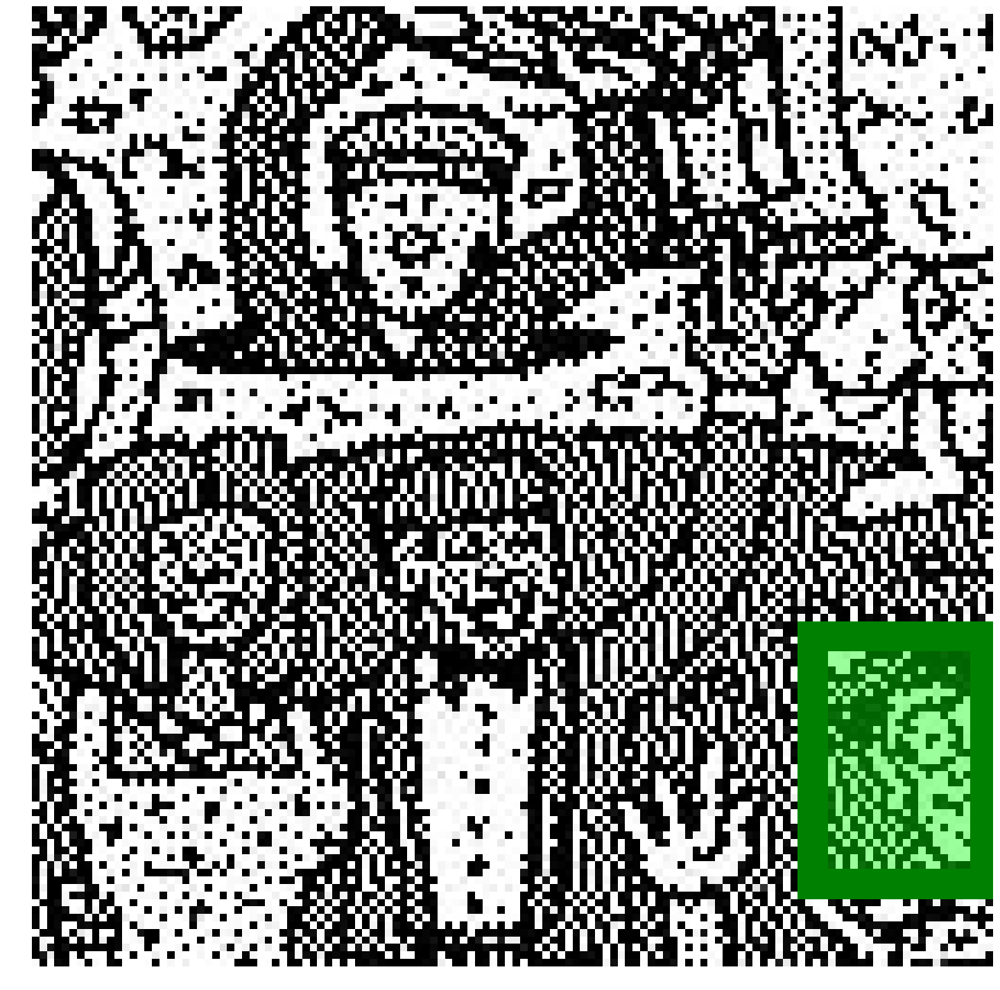

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/84G.jpg: 128x128


2024-11-03 18:43:22.259527: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 AVX512F FMA
2024-11-03 18:43:22.289510: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2100000000 Hz
2024-11-03 18:43:22.289973: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x55fd9cfa4690 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2024-11-03 18:43:22.290029: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version


Metrics for /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/84G.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 1.00


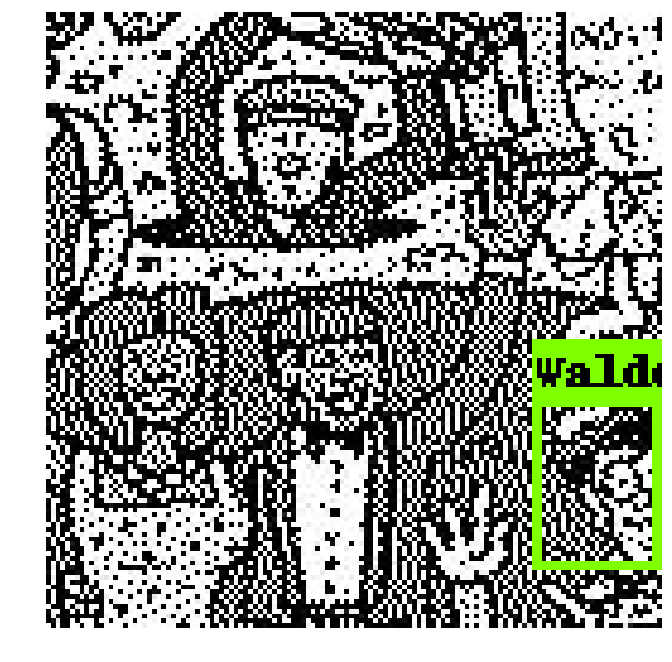

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/81B.jpg


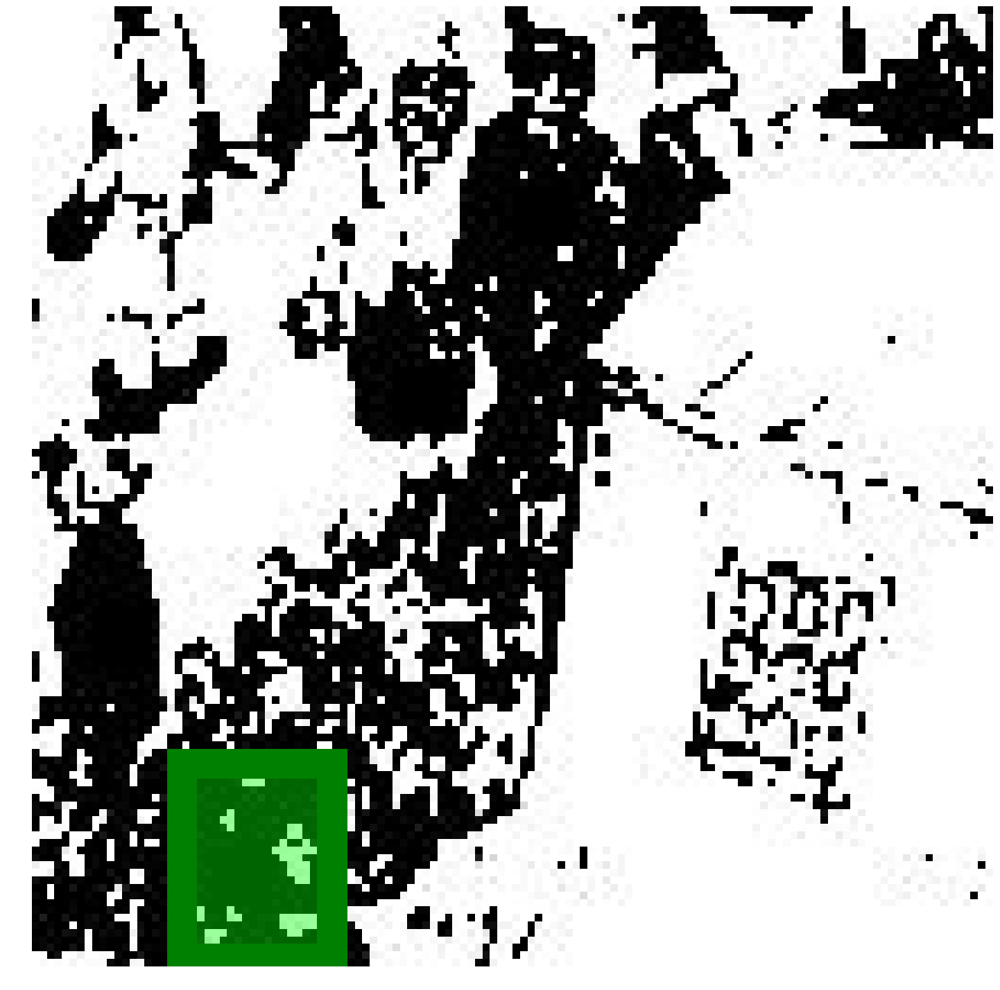

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/81B.jpg: 128x128
Metrics for /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/81B.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.95


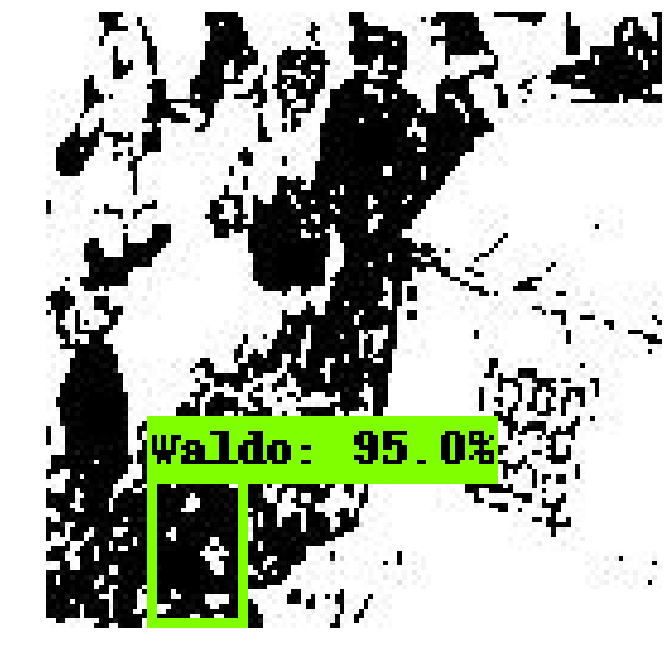

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/107G.jpg


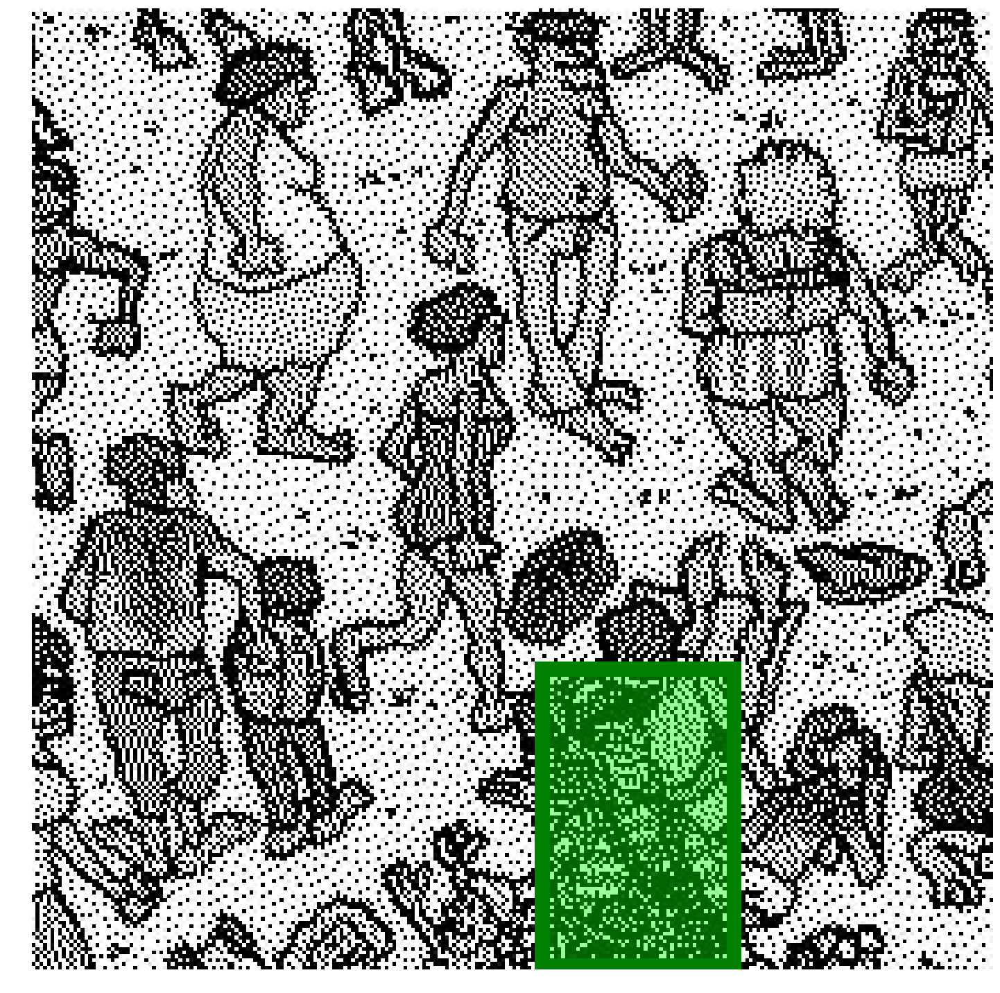

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/107G.jpg: 256x256
Metrics for /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/107G.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.95


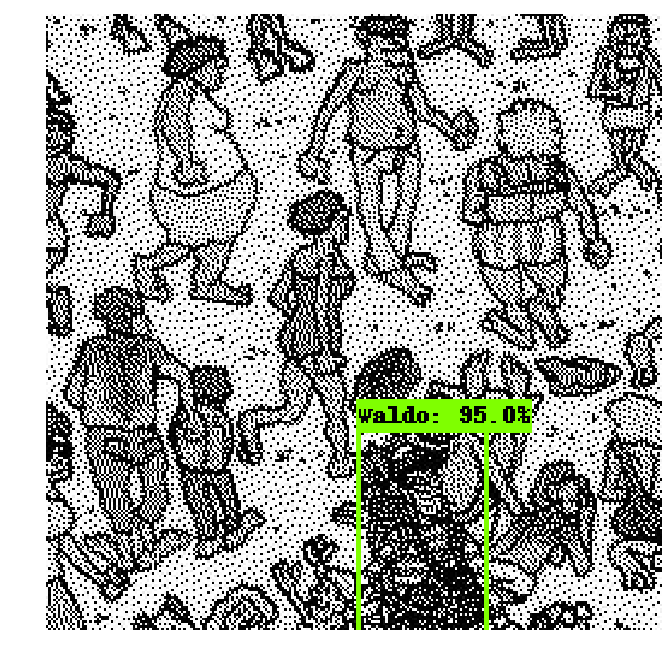

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/105B.jpg


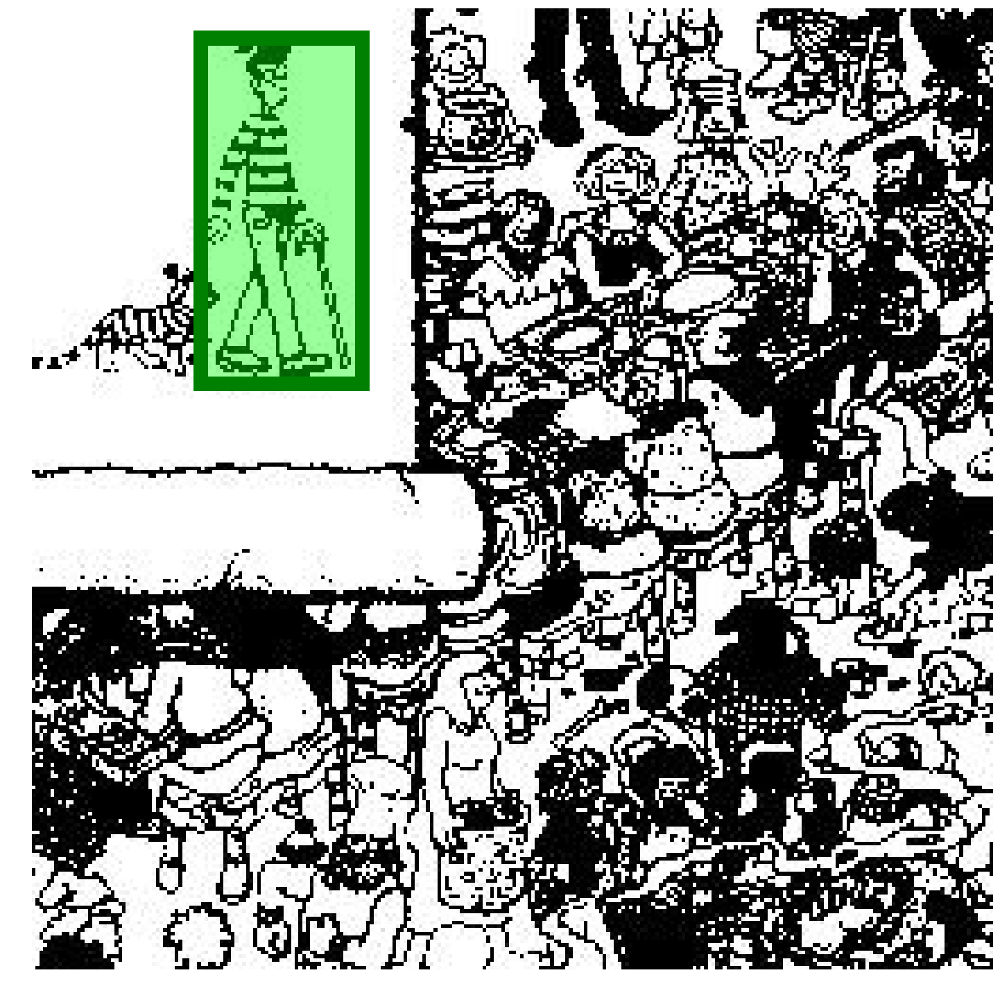

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/105B.jpg: 256x256
Metrics for /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/105B.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.99


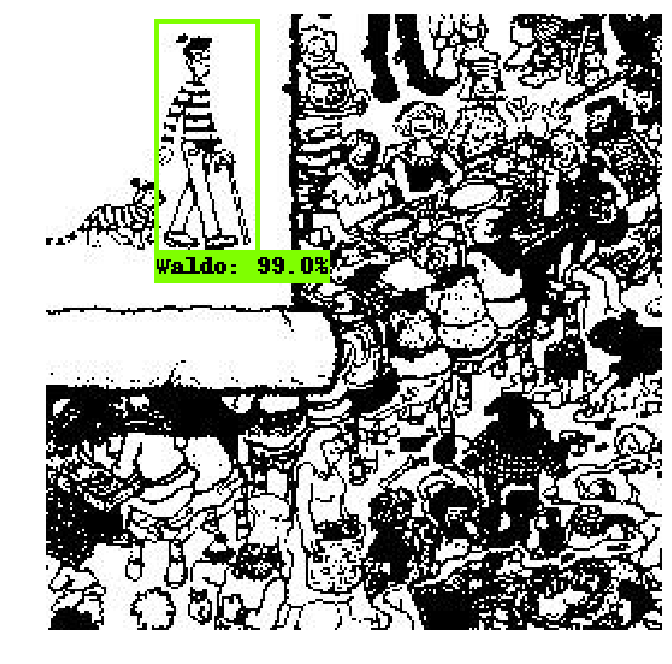

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/51.jpg


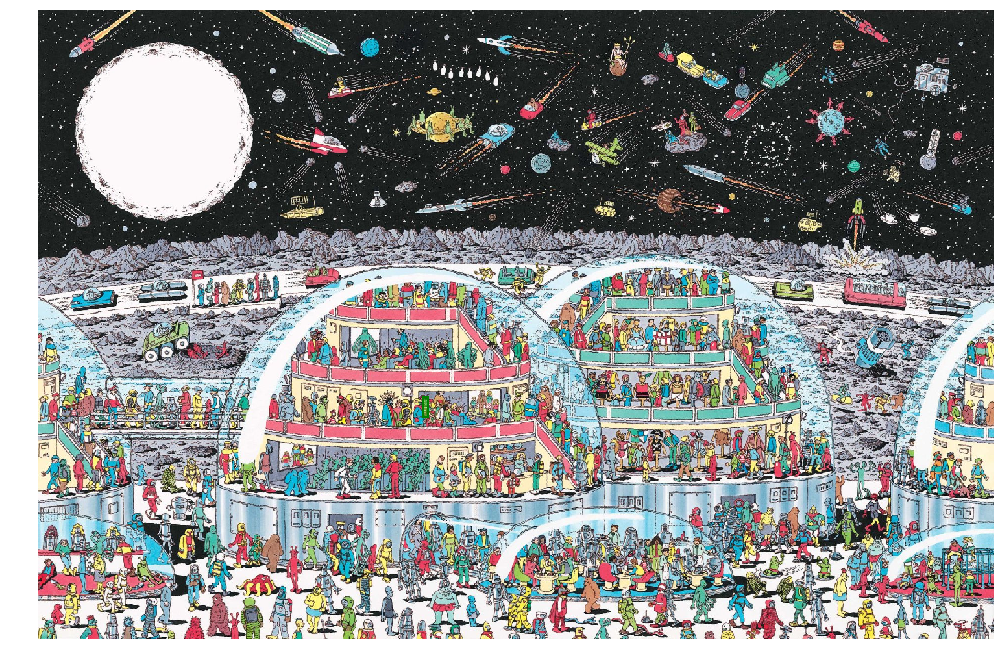

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/51.jpg: 1920x1264


/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/mnt/homeGPU/azapata/ENTORNO/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Metrics for /mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection/VAL_VISUAL/51.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


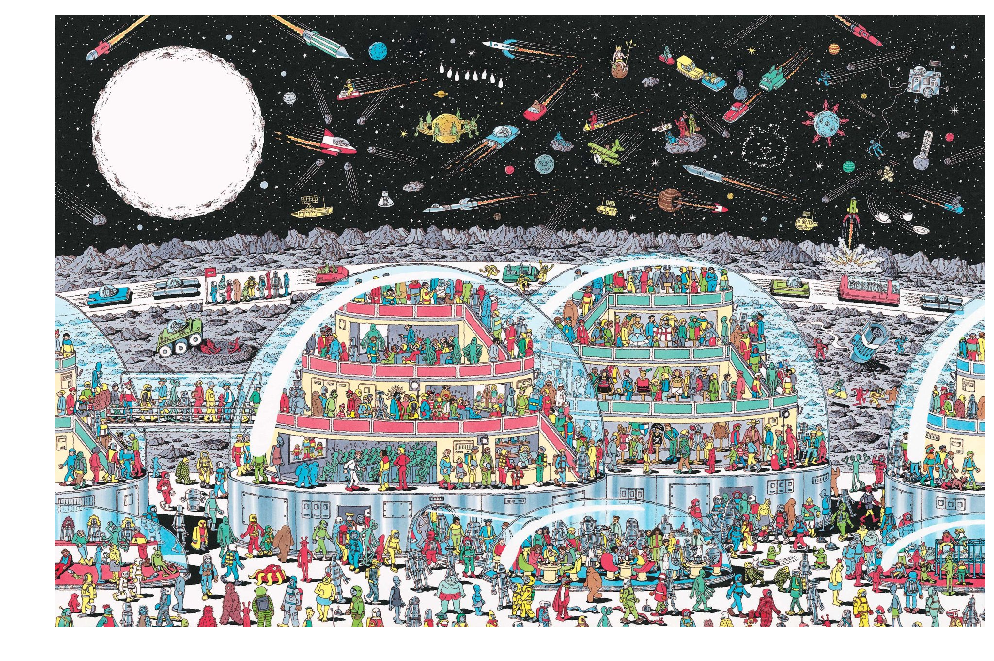

In [35]:
import os
import tensorflow as tf
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw
import xml.etree.ElementTree as ET
import random

# Directorio del proyecto y de las imágenes/etiquetas
repo_dir_path = "/mnt/homeGPU/azapata/WhereIsWaldo/ObjectDetection"
PATH_TO_TEST_IMAGES_DIR = os.path.join(repo_dir_path, "VAL_VISUAL")
PATH_TO_TEST_LABELS_DIR = os.path.join(repo_dir_path, "VAL_VISUAL_LABELS")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

os.chdir(repo_dir_path)
%matplotlib inline

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True
    )
    return len(categories)

# Cargar el archivo de clases
num_classes = get_num_classes(label_map_pbtxt_fname)

# Configuración y carga del modelo de detección
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

from object_detection.utils import label_map_util
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True
)
category_index = label_map_util.create_category_index(categories)

def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

IMAGE_SIZE = (12, 8)

def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.compat.v1.Session() as sess:
            ops = tf.compat.v1.get_default_graph().get_operations()
            tensor_dict = {
                output.name: tf.compat.v1.get_default_graph().get_tensor_by_name(output.name)
                for op in ops for output in op.outputs
            }
            image_tensor = tensor_dict['image_tensor:0']
            
            output_dict = sess.run(
                {
                    'num_detections': tensor_dict['num_detections:0'],
                    'detection_boxes': tensor_dict['detection_boxes:0'],
                    'detection_scores': tensor_dict['detection_scores:0'],
                    'detection_classes': tensor_dict['detection_classes:0'],
                },
                feed_dict={image_tensor: np.expand_dims(image, 0)}
            )
            
            output_dict['num_detections'] = int(output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict['detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
    return output_dict

def calculate_metrics(output_dict, iou_threshold=0.5):
    detection_scores = output_dict['detection_scores']
    detection_boxes = output_dict['detection_boxes']
    detections_above_threshold = detection_scores[detection_scores >= 0.5]
    precision = len(detections_above_threshold) / len(detection_scores)
    recall = len(detections_above_threshold) / output_dict['num_detections']
    avg_confidence = np.mean(detections_above_threshold)
    return precision, recall, avg_confidence

# Número de imágenes a procesar aleatoriamente
num_images_to_process = 5

# Seleccionar aleatoriamente un subconjunto de imágenes
all_images = os.listdir(PATH_TO_TEST_IMAGES_DIR)
sampled_images = random.sample(all_images, min(num_images_to_process, len(all_images)))

# Ejecutar detecciones en las imágenes seleccionadas
for image_name in sampled_images:
    # Construir rutas de archivo para la imagen y su correspondiente XML
    image_path = os.path.join(PATH_TO_TEST_IMAGES_DIR, image_name)
    xml_name = image_name.replace(".jpg", ".xml")
    xml_path = os.path.join(PATH_TO_TEST_LABELS_DIR, xml_name)
    
    print(f"Mostrando la imagen con las etiquetas originales para {image_path}")
    show_image_with_bounding_box(xml_path, image_path)
    
    # Procesar imagen y obtener tamaño
    image = Image.open(image_path)
    im_width, im_height = image.size
    print(f"Tamaño de la imagen {image_path}: {im_width}x{im_height}")
    
    image_np = load_image_into_numpy_array(image)
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    
    # Calcular métricas
    precision, recall, avg_confidence = calculate_metrics(output_dict)
    print(f"Metrics for {image_path}:")
    print(f" - Precision: {precision:.2f}")
    print(f" - Recall: {recall:.2f}")
    print(f" - Avg Confidence: {avg_confidence:.2f}")

    # Visualización de los resultados de detección
    from object_detection.utils import visualization_utils as vis_util
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        min_score_thresh=0.6,
        line_thickness=2
    )
    
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)
    plt.axis('off')
    plt.show()


# **PROBAMOS CON FOTOS ALEATORIAS DE INTERNET**

In [36]:
import glob

pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname
     

['/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/1.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/10.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/11.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/12.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/13.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/2.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/3.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/4.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/5.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/6.jpg', '/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/7.jpg', '/mnt/homeGPU/azapata/Where

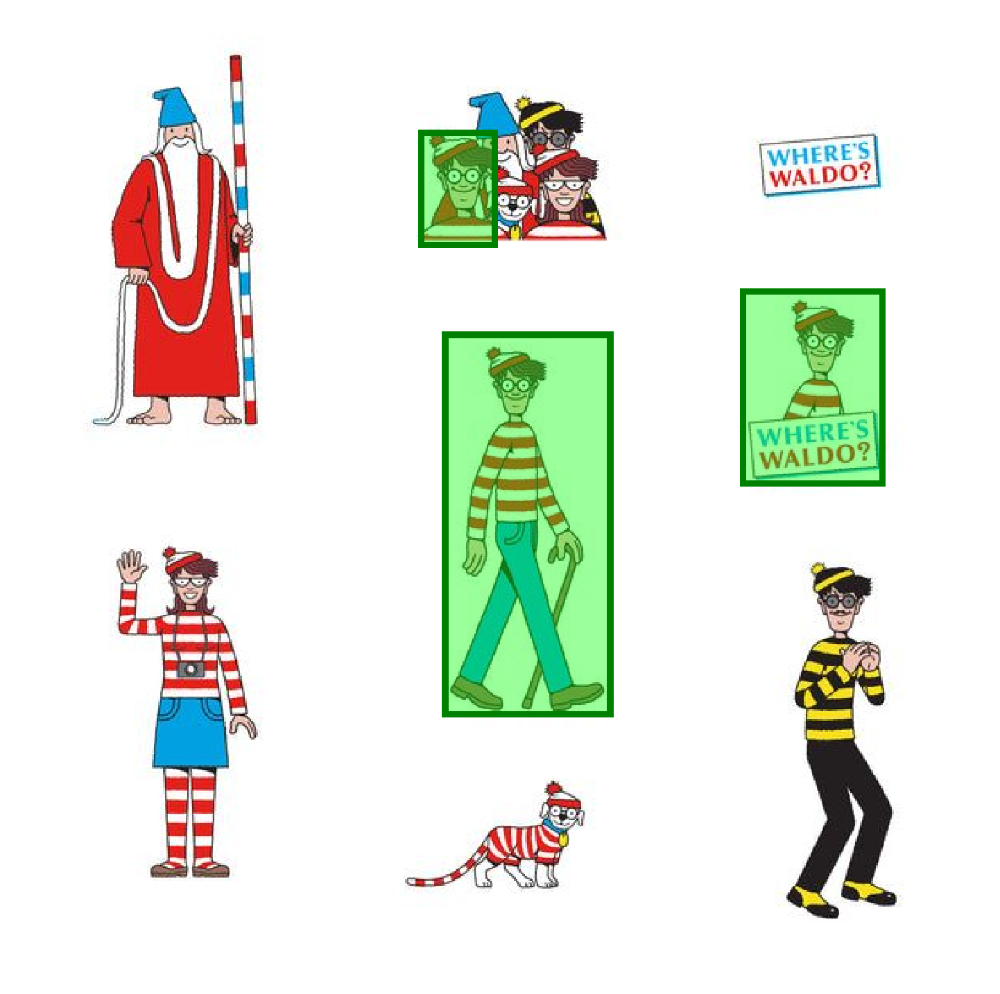

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/1.jpg: 600x600
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/1.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.99


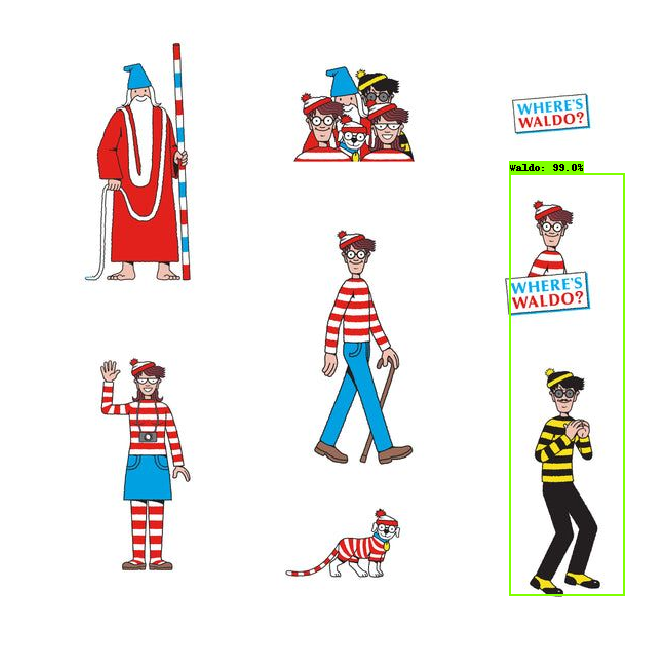

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/10.jpg


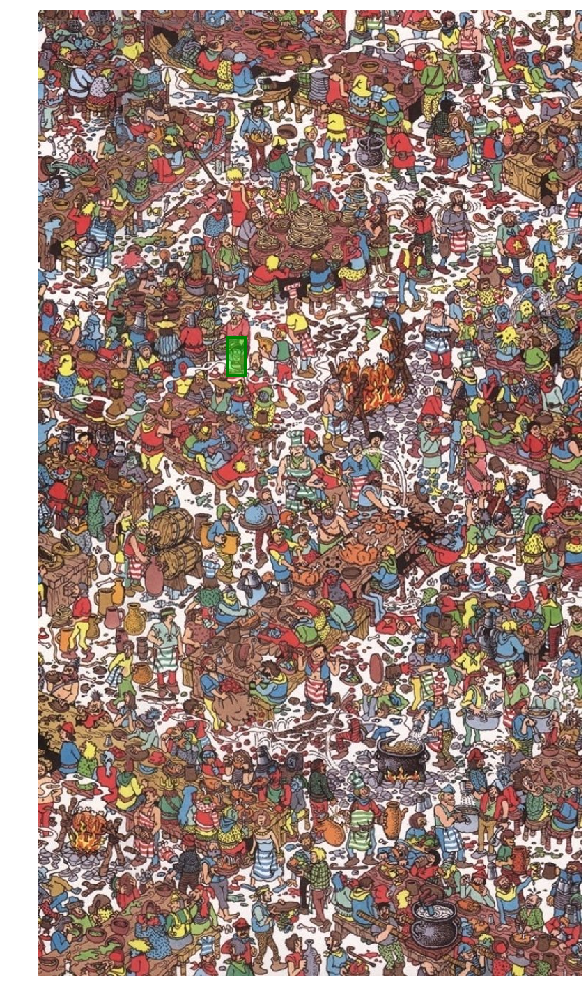

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/10.jpg: 750x1334
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/10.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


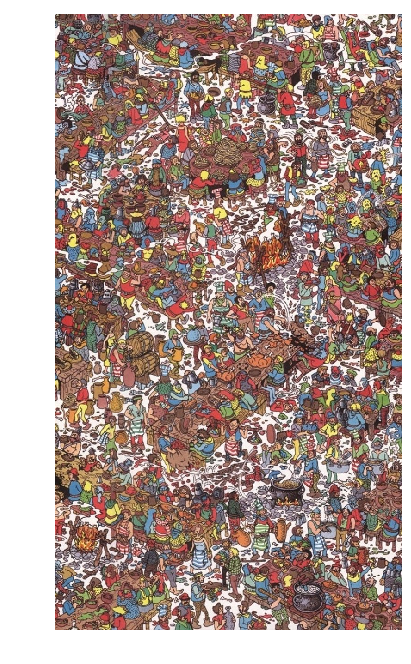

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/11.jpg


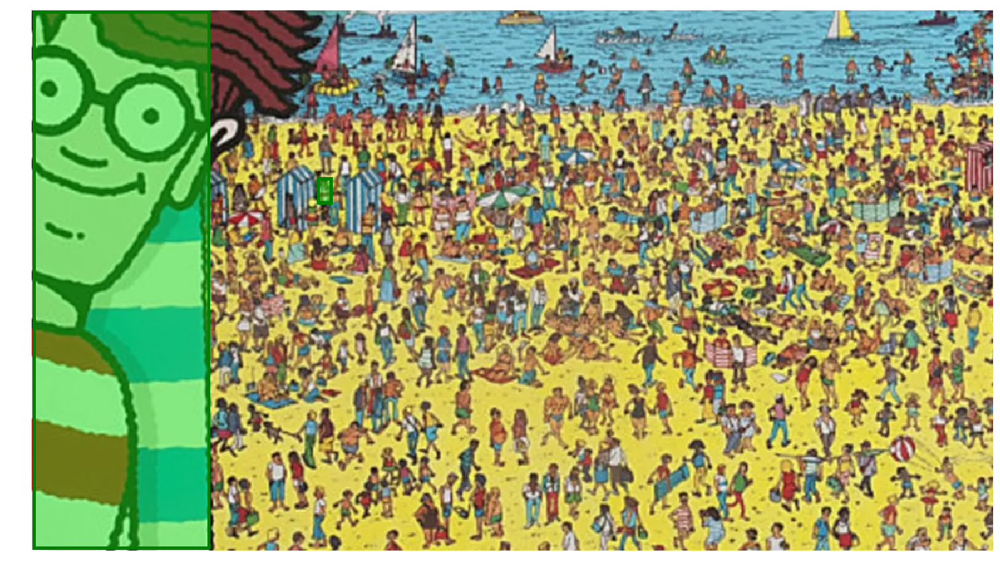

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/11.jpg: 1200x675
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/11.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


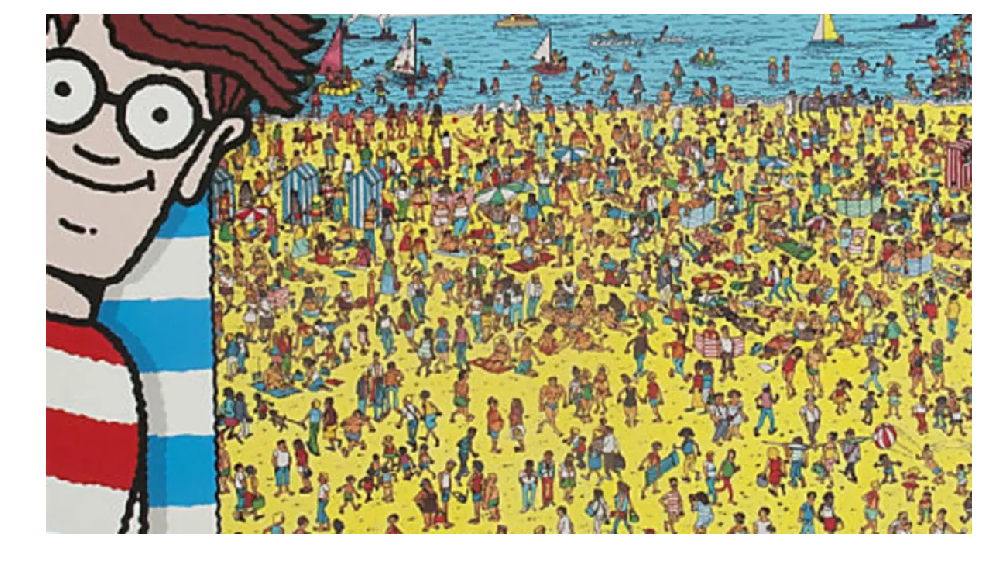

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/12.jpg


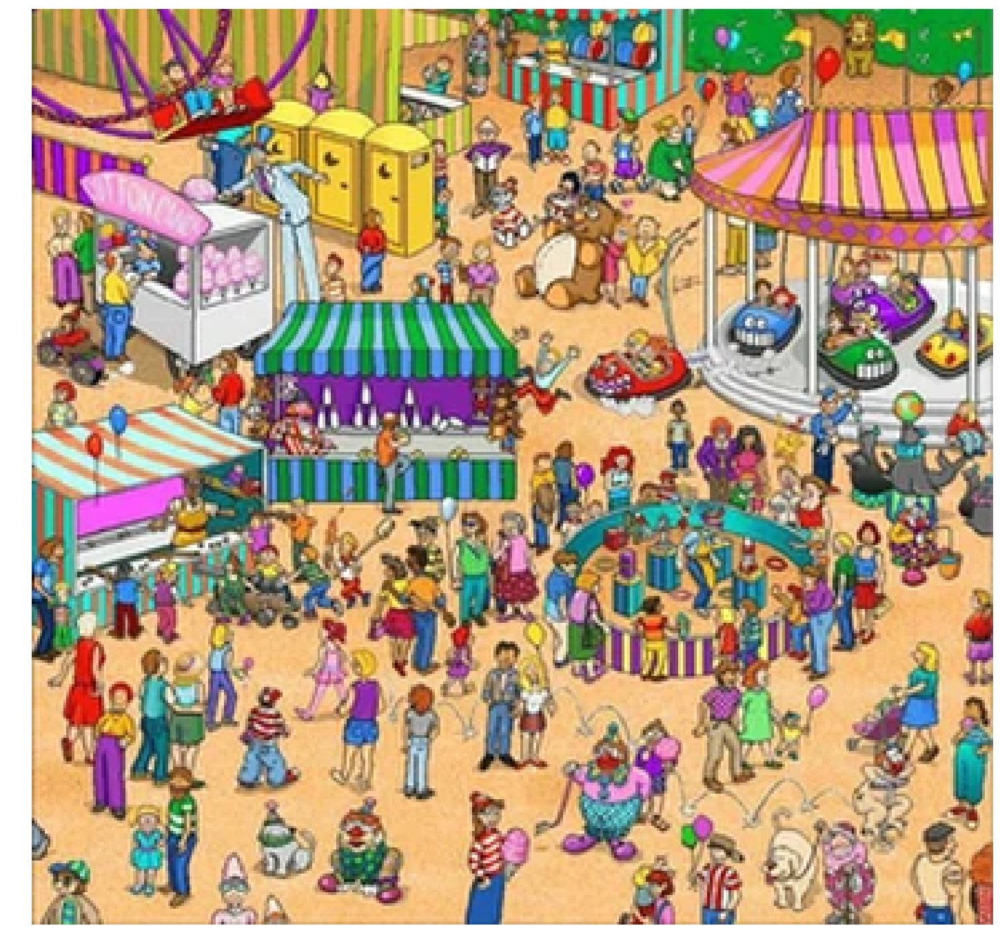

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/12.jpg: 360x343
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/12.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


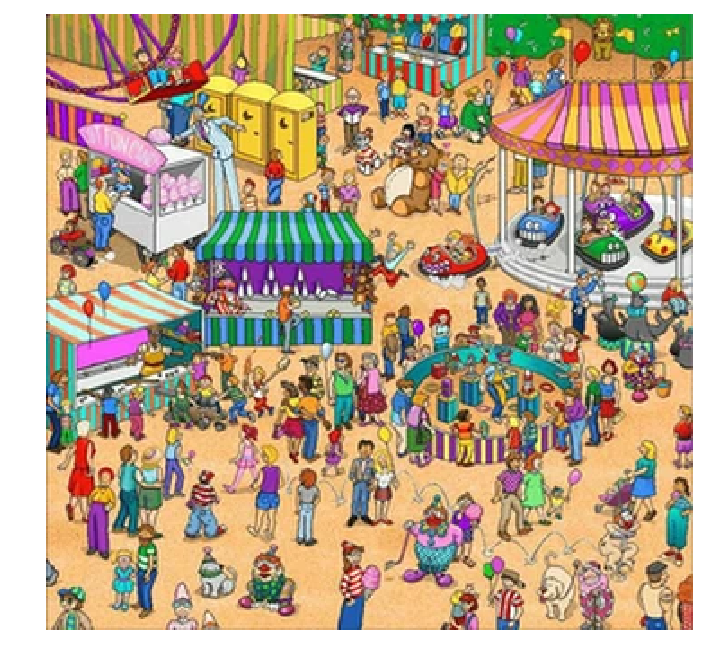

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/13.jpg


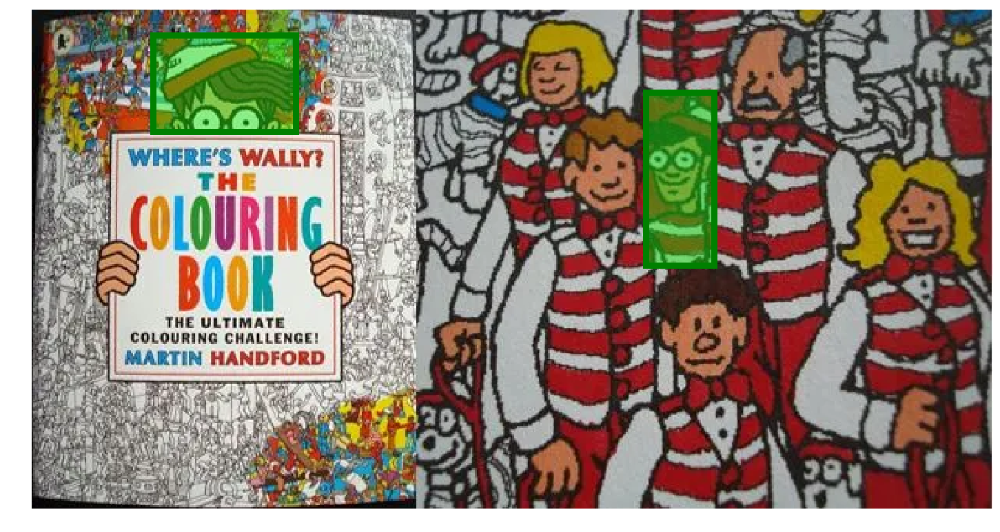

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/13.jpg: 618x321
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/13.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


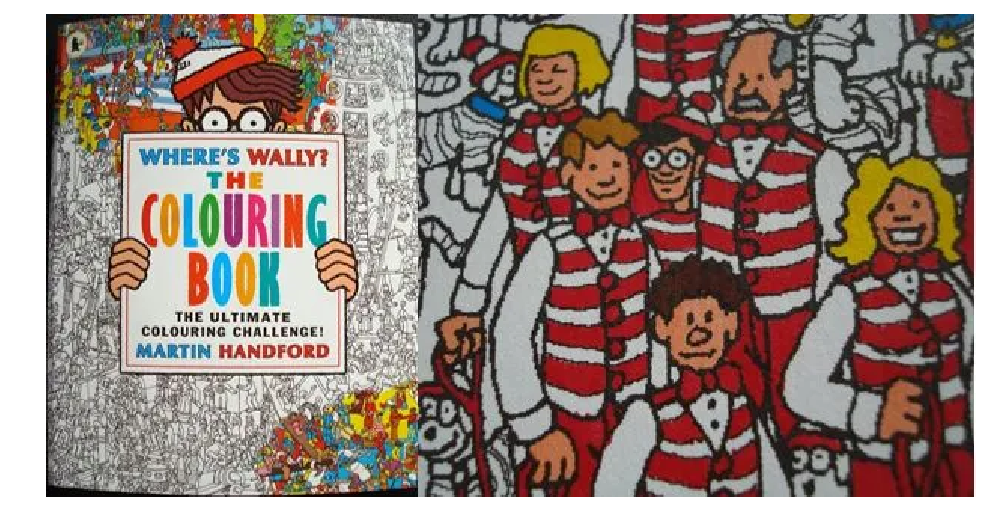

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/2.jpg


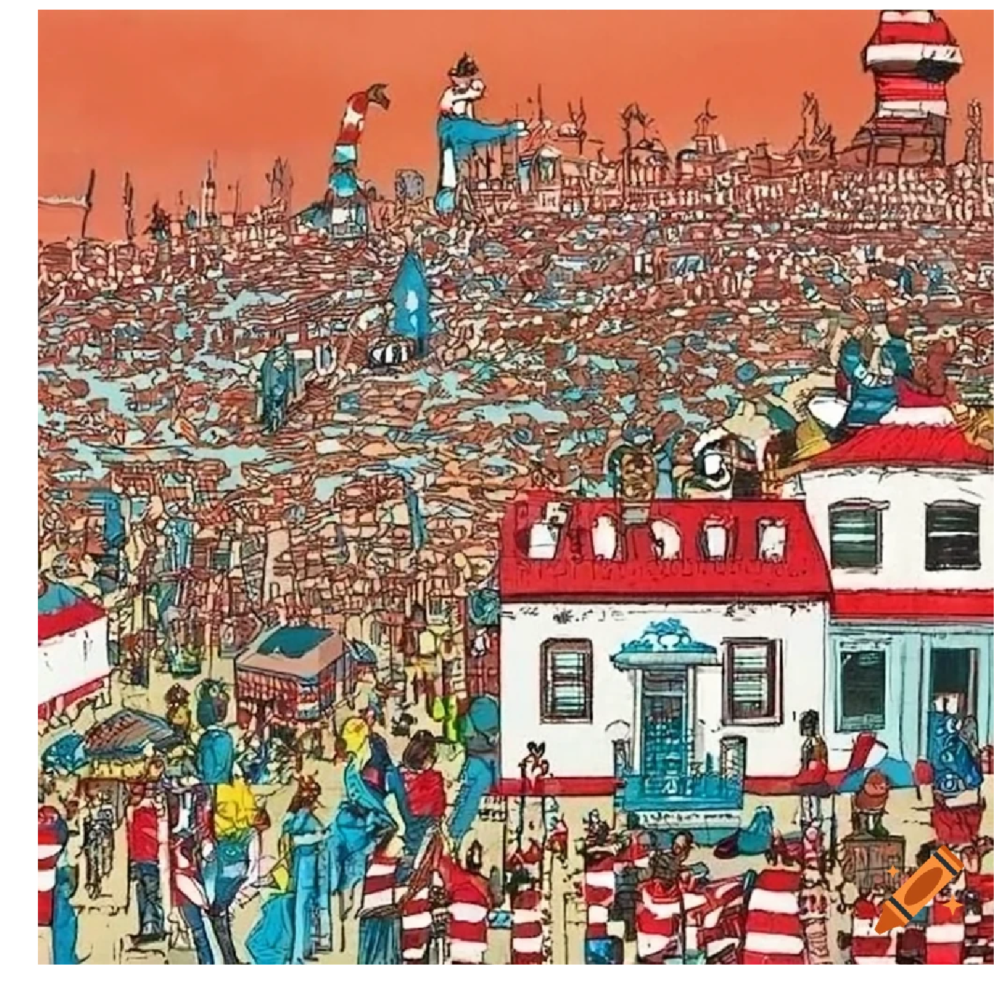

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/2.jpg: 1024x1024
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/2.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


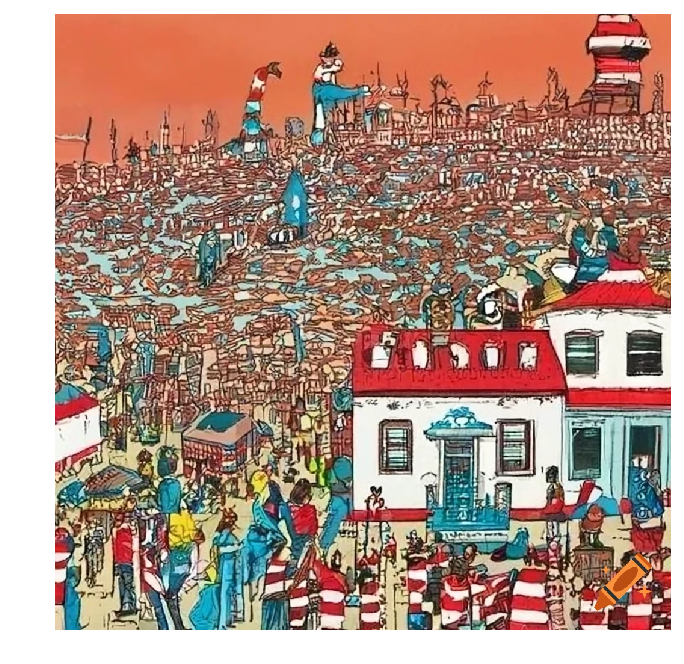

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/3.jpg


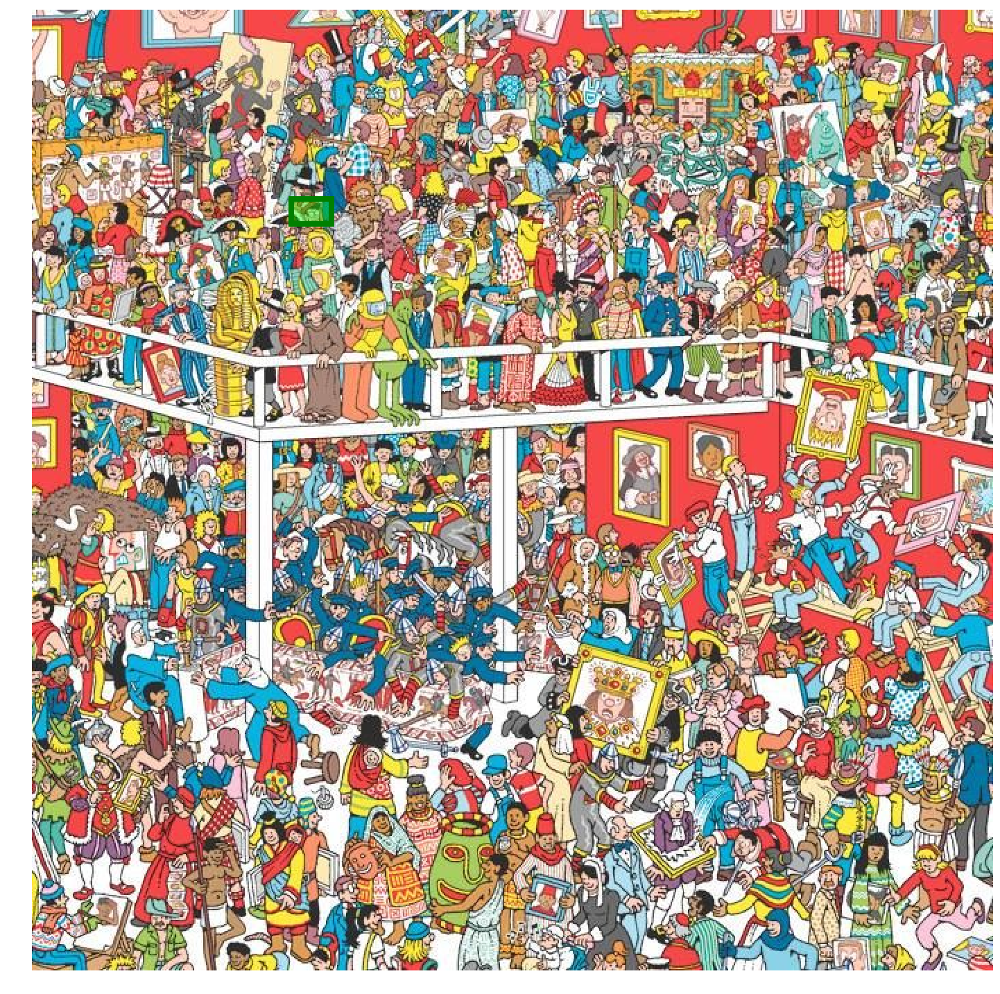

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/3.jpg: 700x700
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/3.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


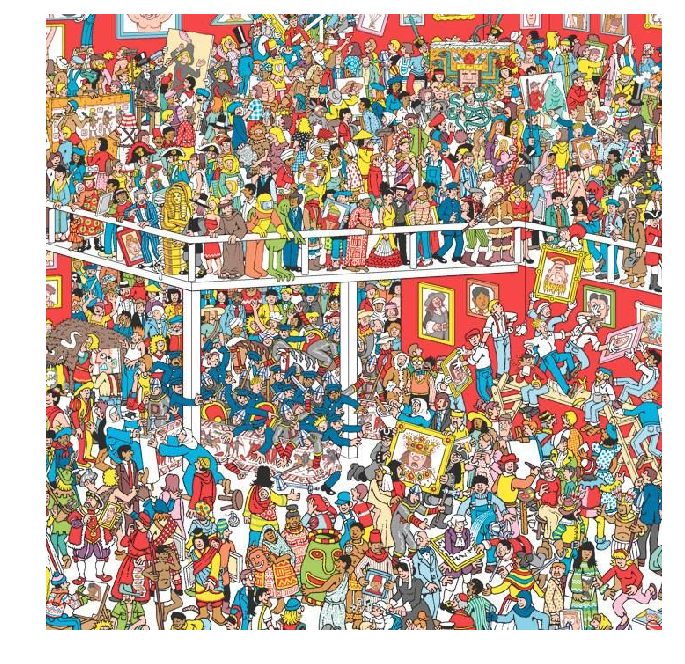

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/4.jpg


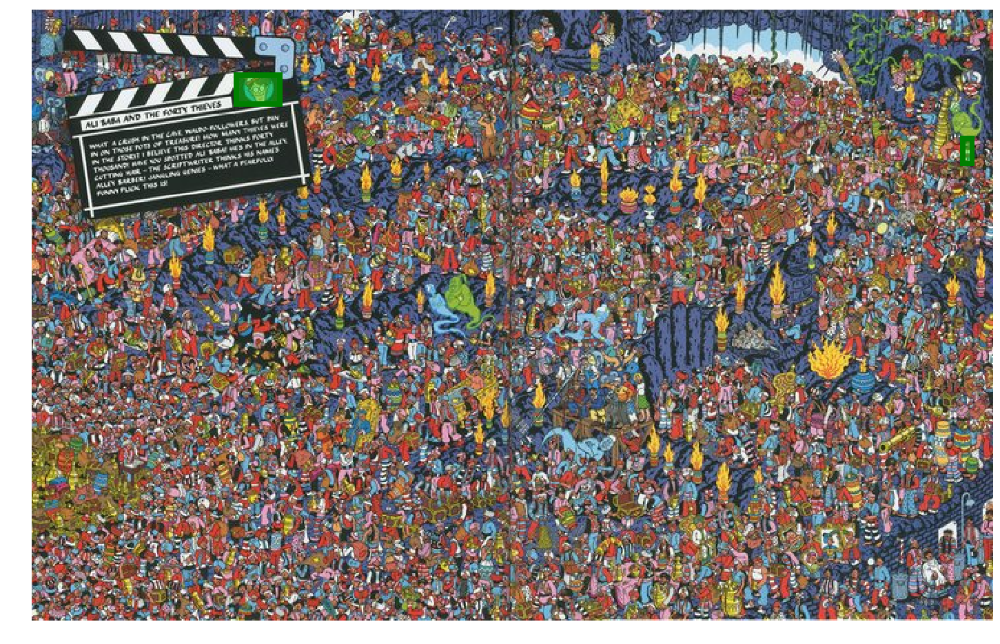

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/4.jpg: 728x463
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/4.jpg:
 - Precision: 0.02
 - Recall: 0.02
 - Avg Confidence: 0.99


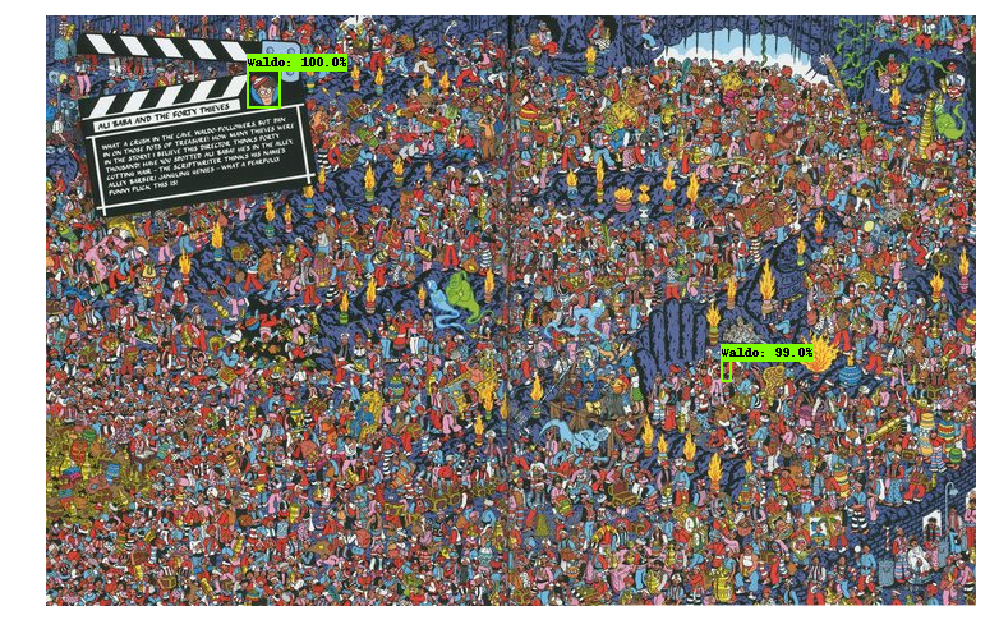

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/5.jpg


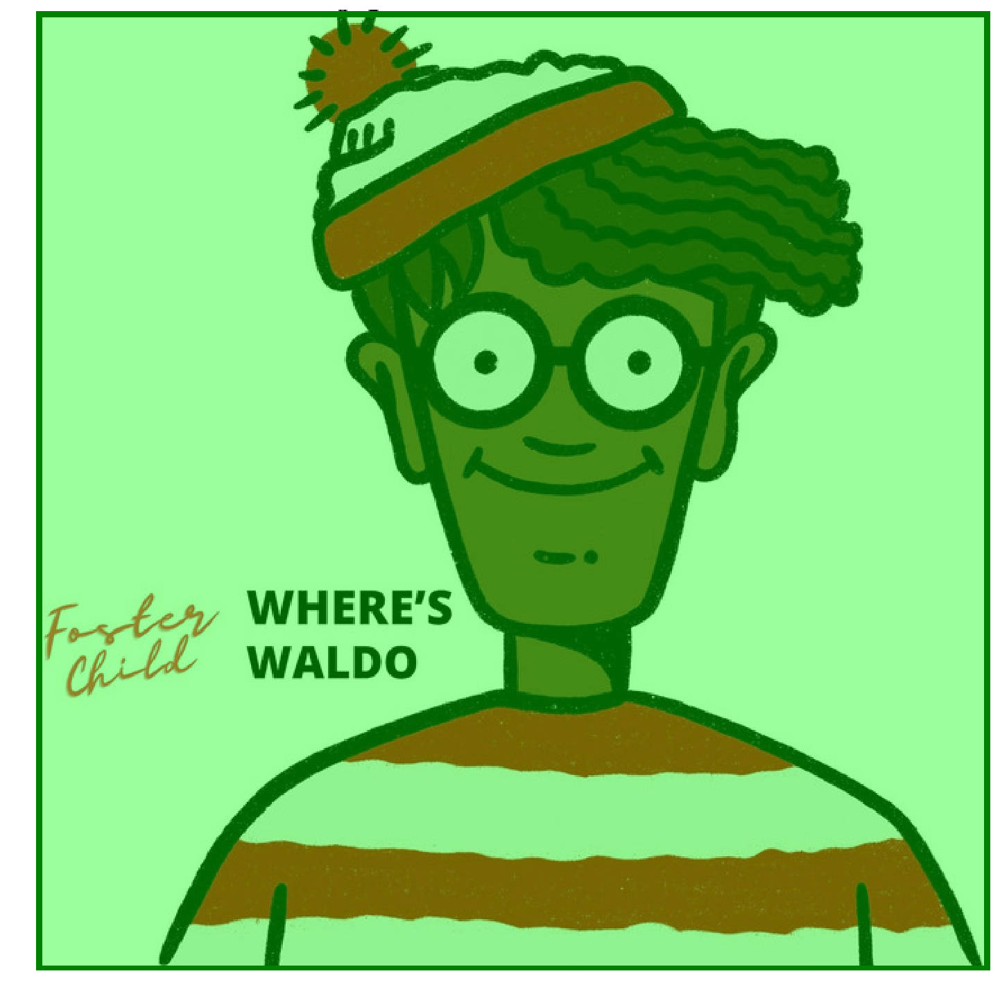

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/5.jpg: 640x640
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/5.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 1.00


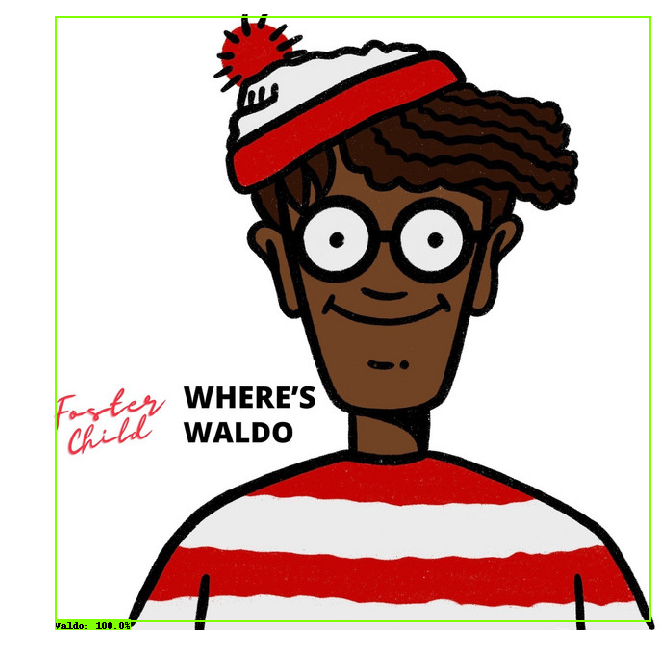

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/6.jpg


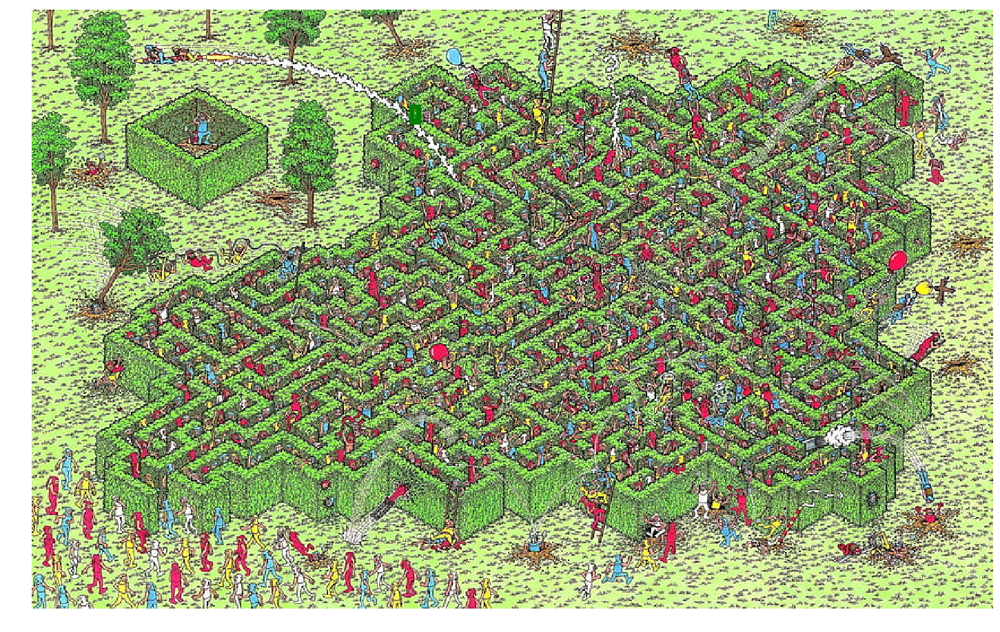

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/6.jpg: 850x530
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/6.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.86


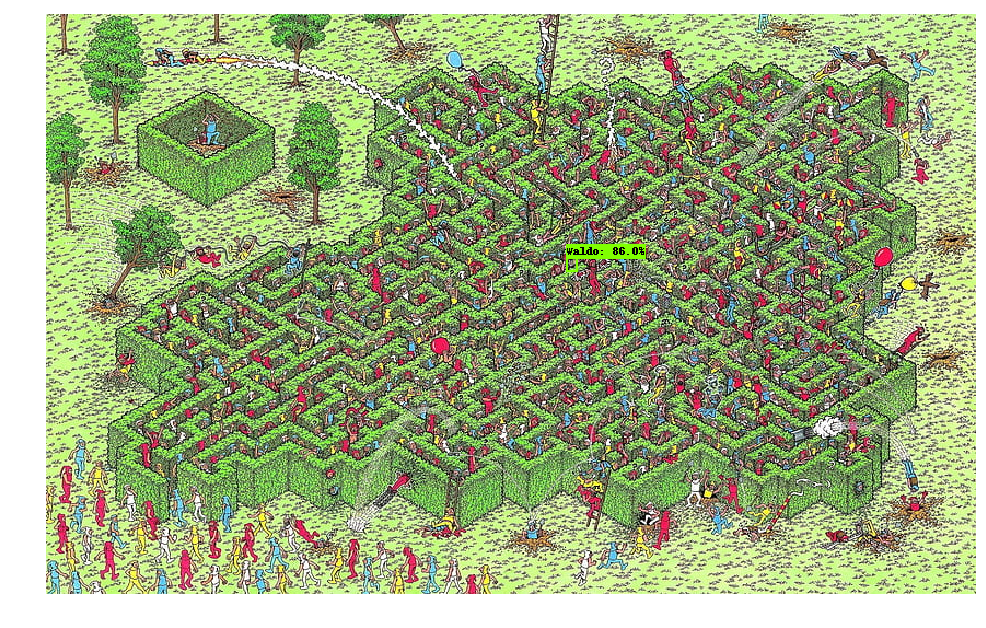

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/7.jpg


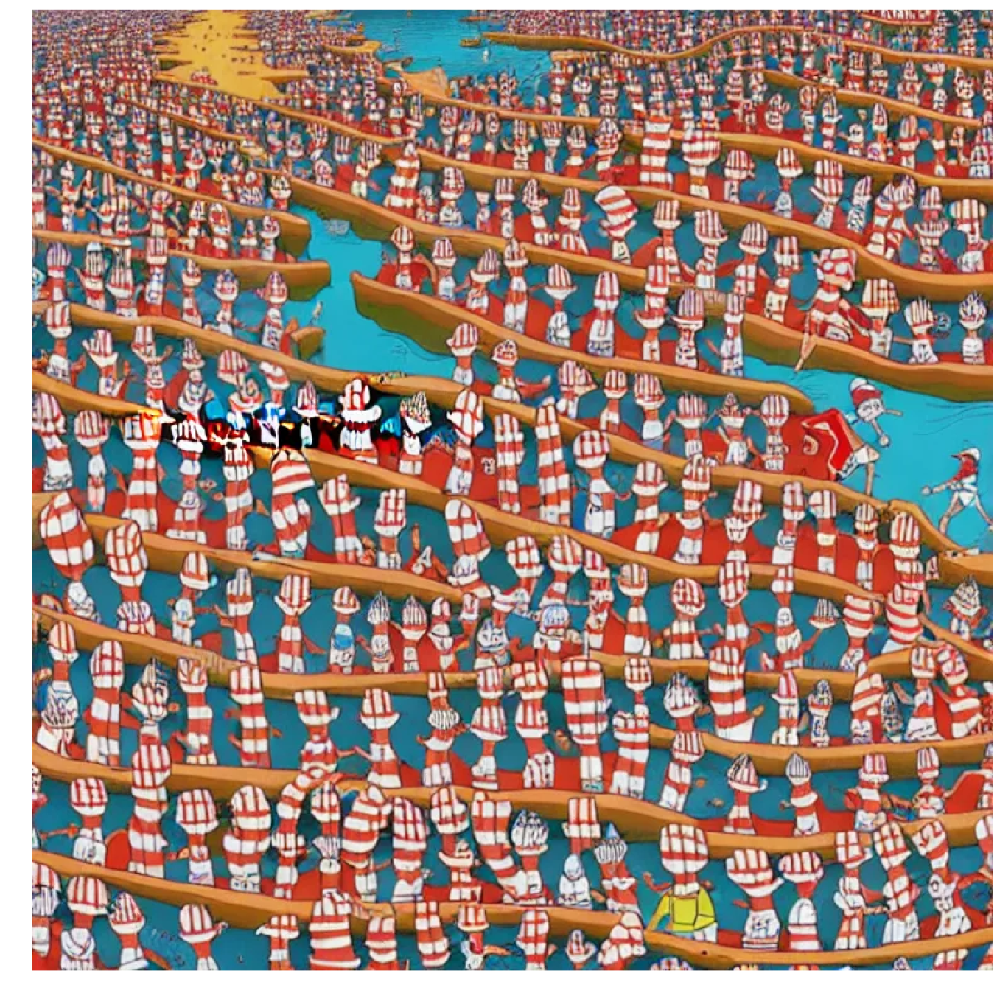

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/7.jpg: 768x768
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/7.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


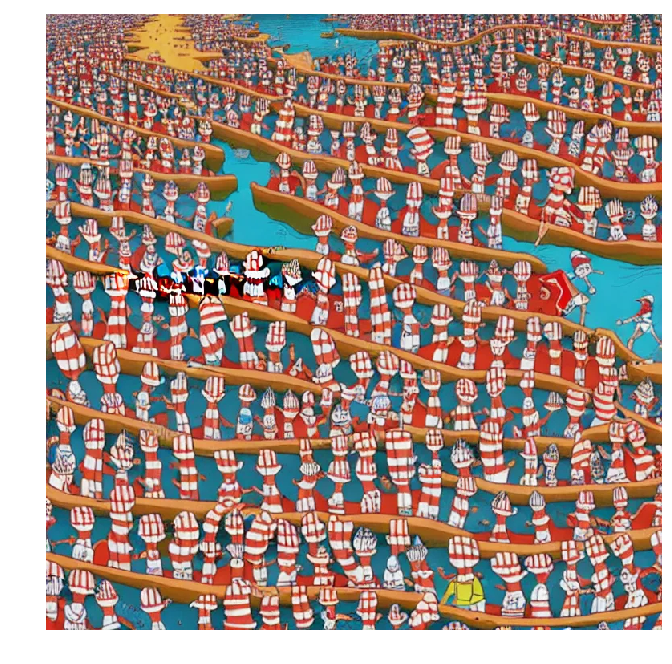

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/8.jpg


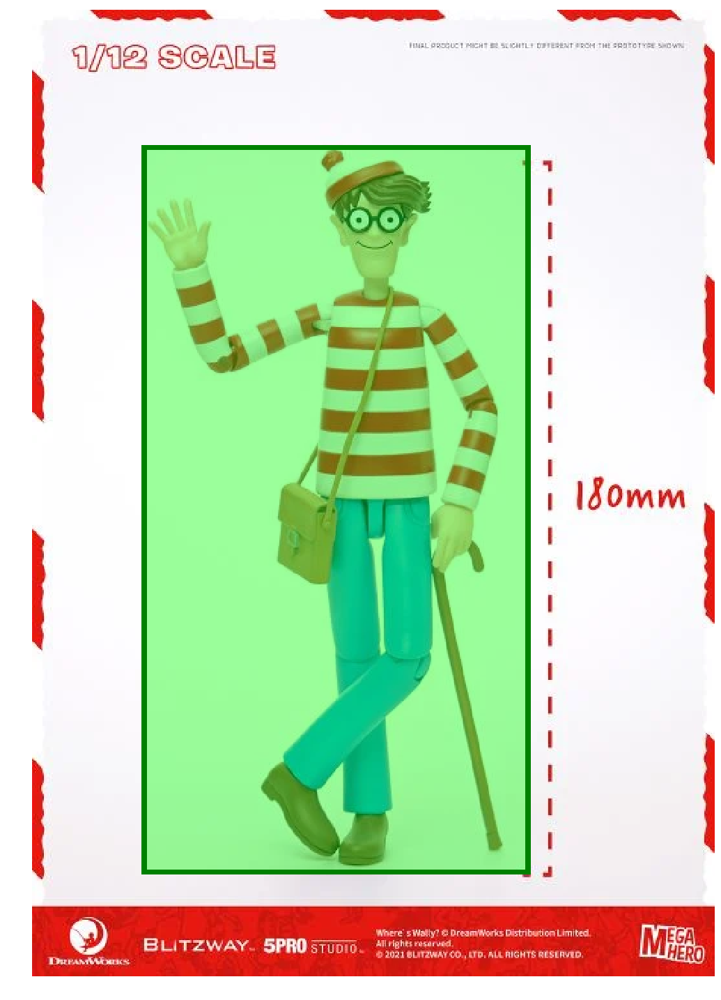

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/8.jpg: 530x750
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/8.jpg:
 - Precision: 0.01
 - Recall: 0.01
 - Avg Confidence: 0.69


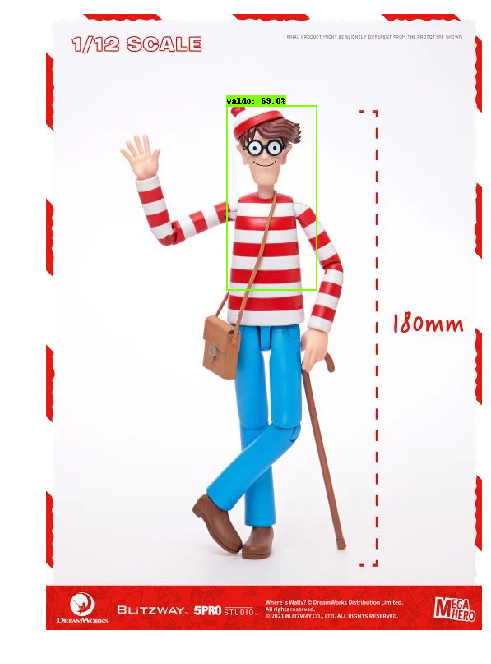

Mostrando la imagen con las etiquetas originales para /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/9.jpg


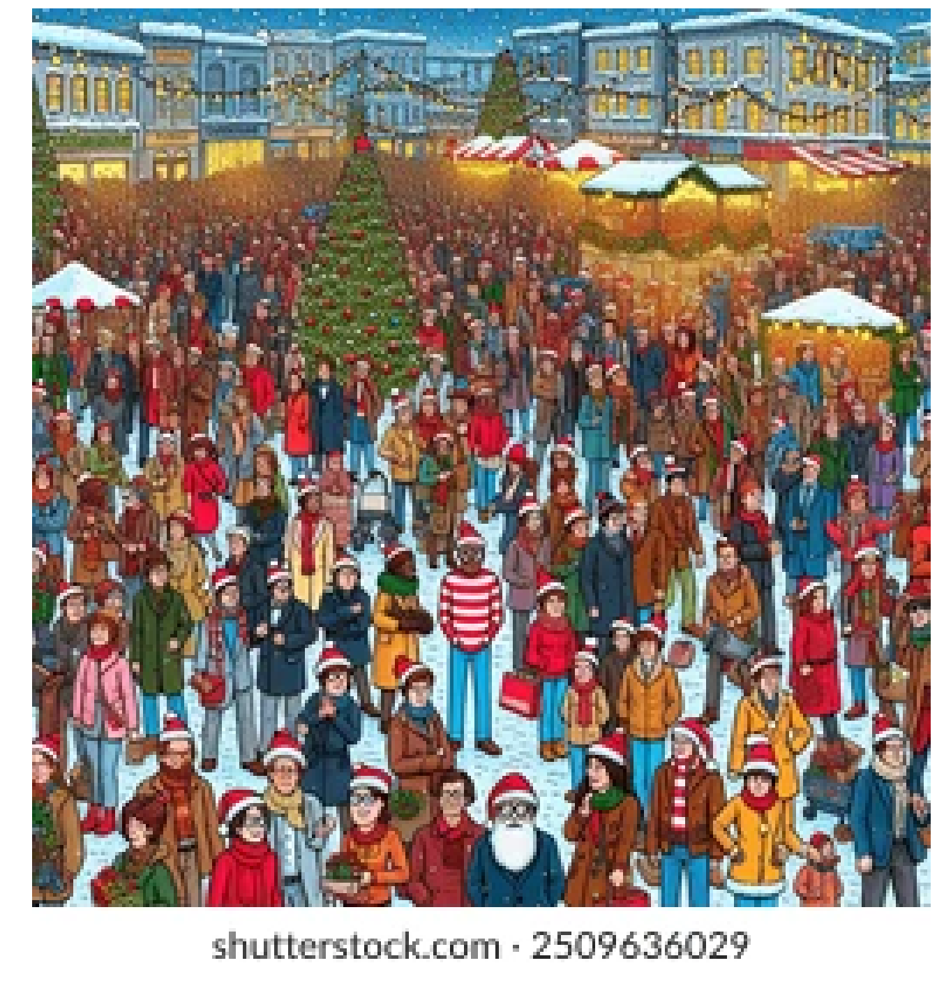

Tamaño de la imagen /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/9.jpg: 260x280
Metrics for /mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection/DATOS_WALDO/images/9.jpg:
 - Precision: 0.00
 - Recall: 0.00
 - Avg Confidence: nan


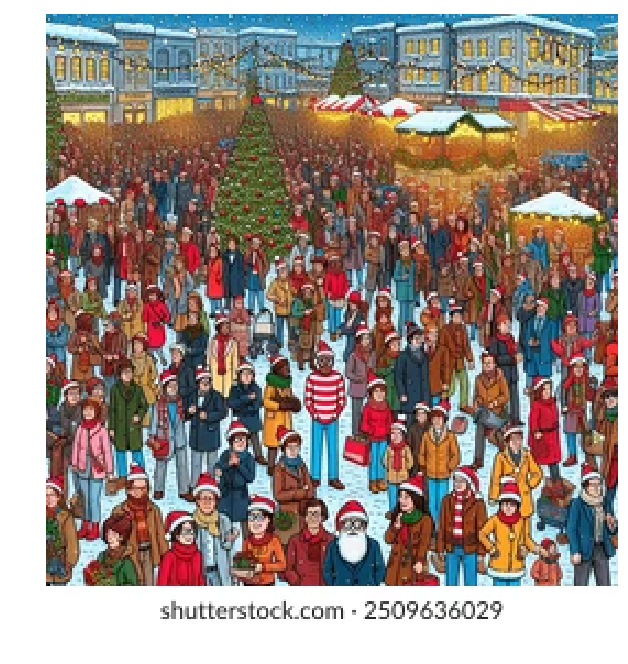

In [37]:
import os
import tensorflow as tf
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw
import xml.etree.ElementTree as ET

# Directorio del proyecto y de las imágenes/etiquetas
repo_dir_path = "/mnt/homeGPU/azapata/WhereIsWaldoFasterRCNN/ObjectDetection"
PATH_TO_TEST_IMAGES_DIR = os.path.join(repo_dir_path, "DATOS_WALDO/images")
PATH_TO_TEST_LABELS_DIR = os.path.join(repo_dir_path, "DATOS_WALDO/labels")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

os.chdir(repo_dir_path)
%matplotlib inline

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True
    )
    return len(categories)

# Cargar el archivo de clases
num_classes = get_num_classes(label_map_pbtxt_fname)

# Configuración y carga del modelo de detección
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

from object_detection.utils import label_map_util
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True
)
category_index = label_map_util.create_category_index(categories)

def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

IMAGE_SIZE = (12, 8)

def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.compat.v1.Session() as sess:
            ops = tf.compat.v1.get_default_graph().get_operations()
            tensor_dict = {
                output.name: tf.compat.v1.get_default_graph().get_tensor_by_name(output.name)
                for op in ops for output in op.outputs
            }
            image_tensor = tensor_dict['image_tensor:0']
            
            output_dict = sess.run(
                {
                    'num_detections': tensor_dict['num_detections:0'],
                    'detection_boxes': tensor_dict['detection_boxes:0'],
                    'detection_scores': tensor_dict['detection_scores:0'],
                    'detection_classes': tensor_dict['detection_classes:0'],
                },
                feed_dict={image_tensor: np.expand_dims(image, 0)}
            )
            
            output_dict['num_detections'] = int(output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict['detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
    return output_dict

def calculate_metrics(output_dict, iou_threshold=0.5):
    detection_scores = output_dict['detection_scores']
    detection_boxes = output_dict['detection_boxes']
    detections_above_threshold = detection_scores[detection_scores >= 0.5]
    precision = len(detections_above_threshold) / len(detection_scores)
    recall = len(detections_above_threshold) / output_dict['num_detections']
    avg_confidence = np.mean(detections_above_threshold)
    return precision, recall, avg_confidence

def show_image_with_bounding_box(xml_path, image_path):
    # Parseo del archivo XML
    tree = ET.parse(xml_path)
    root = tree.getroot()
    
    # Cargar la imagen
    image = Image.open(image_path).convert("RGBA")
    overlay = Image.new("RGBA", image.size, (255, 255, 255, 0))  # Capa transparente para la bounding box
    
    # Obtención de las coordenadas de la bounding box
    for obj in root.findall('object'):
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)
        
        # Dibujar el rectángulo con relleno semitransparente
        draw = ImageDraw.Draw(overlay)
        draw.rectangle([(xmin, ymin), (xmax, ymax)], outline="green", width=4, fill=(0, 255, 0, 100))  # Verde con opacidad

    # Superponer la capa con la imagen original
    combined = Image.alpha_composite(image, overlay).convert("RGB")
    
    # Mostrar la imagen con la bounding box
    plt.figure(figsize=(18, 18))
    plt.imshow(combined)
    plt.axis('off')
    plt.show()

# Ejecutar detecciones en cada imagen y visualizar resultados con métricas
for image_name in os.listdir(PATH_TO_TEST_IMAGES_DIR):
    # Construir rutas de archivo para la imagen y su correspondiente XML
    image_path = os.path.join(PATH_TO_TEST_IMAGES_DIR, image_name)
    xml_name = image_name.replace(".jpg", ".xml")
    xml_path = os.path.join(PATH_TO_TEST_LABELS_DIR, xml_name)
    
    print(f"Mostrando la imagen con las etiquetas originales para {image_path}")
    show_image_with_bounding_box(xml_path, image_path)
    
    # Procesar imagen y obtener tamaño
    image = Image.open(image_path)
    im_width, im_height = image.size
    print(f"Tamaño de la imagen {image_path}: {im_width}x{im_height}")
    
    image_np = load_image_into_numpy_array(image)
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    
    # Calcular métricas
    precision, recall, avg_confidence = calculate_metrics(output_dict)
    print(f"Metrics for {image_path}:")
    print(f" - Precision: {precision:.2f}")
    print(f" - Recall: {recall:.2f}")
    print(f" - Avg Confidence: {avg_confidence:.2f}")

    # Visualización de los resultados de detección
    from object_detection.utils import visualization_utils as vis_util
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        min_score_thresh=0.5,
        line_thickness=2
    )
    
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)
    plt.axis('off')
    plt.show()
